# Go Forward ResNet Model
This notebook contains the ResNet model which I used in the web app, model diagnostics, and examples from the test set which I used in webapp for examples

In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, transforms
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import os
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import pandas as pd

In [2]:
# ============================================================================
# DATA LOADING & PREPROCESSING
# ============================================================================


class RAFDBDataset(torch.utils.data.Dataset):
    """Load RAF-DB dataset with numbered folders and CSV labels"""

    def __init__(self, data_dir, labels_file, transform=None):

        self.data_dir = data_dir
        self.transform = transform
        self.images = []
        self.labels = []

        # RAF-DB emotion mapping (your label order): 1=surprised, 2=fearful, 3=disgusted, 4=happy, 5=sad, 6=angry, 7=neutral
        self.emotion_map = {
            0: "surprised",
            1: "fearful",
            2: "disgusted",
            3: "happy",
            4: "sad",
            5: "angry",
            6: "neutral",
        }

        # Load labels from CSV
        df = pd.read_csv(labels_file)
        print(f"Loaded {len(df)} entries from CSV")

        # Load image paths and labels from CSV
        for _, row in df.iterrows():
            img_name = row.iloc[0]  # First column: image name
            label_num = int(row.iloc[1])  # Second column: emotion label (1-7)
            label_idx = label_num - 1  # Convert to 0-indexed (0-6)

            # Construct full path: data_dir/1/image_name or data_dir/2/image_name, etc.
            # RAF-DB structure: numbered folders contain images
            for folder in sorted(os.listdir(data_dir)):
                folder_path = os.path.join(data_dir, folder)
                if not os.path.isdir(folder_path):
                    continue

                img_path = os.path.join(folder_path, img_name)
                if os.path.exists(img_path):
                    self.images.append(img_path)
                    self.labels.append(label_idx)
                    break

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        img = Image.open(img_path).convert("RGB")

        if self.transform:
            img = self.transform(img)

        label = self.labels[idx]
        return img, label


def get_data_transforms():
    """Transforms that upsample 100x100 images to 256x256 for better Grad-CAM"""
    train_transform = transforms.Compose(
        [
            transforms.Resize(
                (256, 256), interpolation=transforms.InterpolationMode.BILINEAR
            ),
            transforms.RandomHorizontalFlip(0.5),
            transforms.RandomRotation(10),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ]
    )

    val_transform = transforms.Compose(
        [
            transforms.Resize(
                (256, 256), interpolation=transforms.InterpolationMode.BILINEAR
            ),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ]
    )

    return train_transform, val_transform

In [3]:
# ============================================================================
# MODEL ARCHITECTURE
# ============================================================================


class EmotionCNN(nn.Module):
    """Emotion detection model optimized for Grad-CAM visualization"""

    def __init__(self, num_emotions=7):
        super(EmotionCNN, self).__init__()
        self.num_emotions = num_emotions

        # Convolutional blocks - keeping feature maps larger for better Grad-CAM
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(64)
        self.pool1 = nn.MaxPool2d(2, 2)  # 256 -> 128

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(128)
        self.pool2 = nn.MaxPool2d(2, 2)  # 128 -> 64

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn3 = nn.BatchNorm2d(256)
        self.pool3 = nn.MaxPool2d(2, 2)  # 64 -> 32

        self.conv4 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.bn4 = nn.BatchNorm2d(512)
        self.pool4 = nn.MaxPool2d(2, 2)  # 32 -> 16

        # Global Average Pooling
        self.global_pool = nn.AdaptiveAvgPool2d((1, 1))

        # Fully connected layers
        self.fc1 = nn.Linear(512, 256)
        self.dropout = nn.Dropout(0.5)
        self.fc2 = nn.Linear(256, num_emotions)

    def forward(self, x):
        x = self.pool1(F.relu(self.bn1(self.conv1(x))))
        x = self.pool2(F.relu(self.bn2(self.conv2(x))))
        x = self.pool3(F.relu(self.bn3(self.conv3(x))))
        x = self.pool4(F.relu(self.bn4(self.conv4(x))))

        x = self.global_pool(x)
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)

        return x


class ResNetEmotionDetector(nn.Module):
    """
    ResNet50-based emotion detector with transfer learning.
    Much better performance than EmotionCNN, especially for small images.
    """

    def __init__(self, num_emotions=7, pretrained=True):
        super(ResNetEmotionDetector, self).__init__()

        # Load pre-trained ResNet50
        self.resnet = models.resnet50(pretrained=pretrained)

        # Freeze early layers (optional - uncomment to freeze first 80% of layers)
        # for param in list(self.resnet.parameters())[:-20]:
        #     param.requires_grad = False

        # Replace final fully connected layer for emotion classification
        num_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(num_features, num_emotions)

    def forward(self, x):
        return self.resnet(x)

In [4]:
# ============================================================================
# GRAD-CAM VISUALIZATION
# ============================================================================


def setup_grad_cam(model, target_layer):
    """Initialize Grad-CAM for visualization"""
    # For M3 Mac (Apple Silicon), don't use use_cuda parameter
    grad_cam = GradCAM(model=model, target_layers=[target_layer])
    return grad_cam


def generate_emotion_cam(
    model, image_path, emotion_names, target_layer, true_label=None
):
    """
    Generate Grad-CAM visualization for a single image.

    Args:
        model: Trained emotion detection model
        image_path: Path to input image
        emotion_names: List of emotion class names (from dataset.emotion_map)
        target_layer: Convolutional layer to visualize
        true_label: Ground truth label index (optional)

    Returns:
        pred_emotion, confidence, cam_heatmap
    """
    # Load and preprocess image
    transform = transforms.Compose(
        [
            transforms.Resize(
                (256, 256), interpolation=transforms.InterpolationMode.BILINEAR
            ),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ]
    )

    img = Image.open(image_path).convert("RGB")
    img_tensor = transform(img).unsqueeze(0)

    # Move to appropriate device (MPS for M3 Mac)
    if torch.cuda.is_available():
        device = torch.device("cuda")
    elif torch.backends.mps.is_available():
        device = torch.device("mps")
    else:
        device = torch.device("cpu")

    img_tensor = img_tensor.to(device)
    model = model.to(device)

    # Get model prediction
    model.eval()
    with torch.no_grad():
        output = model(img_tensor)
        pred_idx = output.argmax(dim=1).item()
        pred_emotion = emotion_names[pred_idx]
        confidence = F.softmax(output, dim=1)[0, pred_idx].item()

    # Get true emotion if provided
    true_emotion = emotion_names[true_label] if true_label is not None else None
    is_correct = (pred_idx == true_label) if true_label is not None else None

    if true_label is not None:
        print(f"True emotion: {true_emotion} (index: {true_label})")
        print(f"Predicted emotion: {pred_emotion} (index: {pred_idx})")
        print(f"Correct: {'✓' if is_correct else '✗'}")
        print(f"Confidence: {confidence:.2%}")
    else:
        print(f"Predicted emotion: {pred_emotion} (index: {pred_idx})")
        print(f"Confidence: {confidence:.2%}")

    # Generate Grad-CAM
    grad_cam = setup_grad_cam(model, target_layer)
    targets = [ClassifierOutputTarget(pred_idx)]

    try:
        cam = grad_cam(input_tensor=img_tensor, targets=targets)
        cam = cam[0, :]
    finally:
        # Properly clean up grad_cam to avoid AttributeError on M3
        if hasattr(grad_cam, "activations_and_grads"):
            grad_cam.activations_and_grads.release()
        del grad_cam

    # Normalize image for visualization and resize to match CAM
    img_array = np.array(img) / 255.0

    # Resize image to 256x256 to match CAM heatmap size
    img_pil = Image.fromarray(np.uint8(img_array * 255)).resize(
        (256, 256), Image.BILINEAR
    )
    img_array = np.array(img_pil) / 255.0

    # Overlay CAM on image
    visualization = show_cam_on_image(img_array, cam, use_rgb=True)

    # Plot results
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    axes[0].imshow(img)
    axes[0].set_title("Original Image (upscaled from 100x100)")
    axes[0].axis("off")

    axes[1].imshow(cam, cmap="jet")
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis("off")

    # Build title for third panel
    if true_label is not None:
        correctness = "✓ Correct" if is_correct else "✗ Incorrect"
        title = f"True: {true_emotion}\nPredicted: {pred_emotion}\nConfidence: {confidence:.2%}\n{correctness}"
        title_color = "green" if is_correct else "red"
    else:
        title = f"Predicted: {pred_emotion}\nConfidence: {confidence:.2%}"
        title_color = "black"

    axes[2].imshow(visualization)
    axes[2].set_title(title, fontsize=11, color=title_color)
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

    return pred_emotion, confidence, cam

In [5]:
# ============================================================================
# TRAINING FUNCTION
# ============================================================================


def train_emotion_model(
    data_dir,
    labels_file,
    num_epochs=10,
    batch_size=32,
    learning_rate=0.001,
    use_resnet=True,
):
    """
    Train emotion detection model on RAF-DB dataset.

    Args:
        data_dir: Path to directory containing numbered subfolders (1, 2, 3, etc.)
        labels_file: Path to train_labels.csv file
        num_epochs: Number of training epochs
        batch_size: Batch size for training
        learning_rate: Learning rate for optimizer
        use_resnet: If True, use ResNet50; if False, use custom EmotionCNN

    Returns:
        model, dataset, emotion_names
    """
    # Use MPS for M3 Mac, CUDA for GPU, CPU as fallback
    if torch.cuda.is_available():
        device = torch.device("cuda")
    elif torch.backends.mps.is_available():
        device = torch.device("mps")
    else:
        device = torch.device("cpu")

    print(f"Using device: {device}")
    print(
        f"Model: {'ResNet50 (Transfer Learning)' if use_resnet else 'Custom EmotionCNN'}\n"
    )

    # Load data
    train_transform, val_transform = get_data_transforms()
    dataset = RAFDBDataset(data_dir, labels_file, transform=train_transform)

    # Create data loader
    dataloader = torch.utils.data.DataLoader(
        dataset, batch_size=batch_size, shuffle=True
    )

    emotion_names = {v: k for k, v in dataset.emotion_map.items()}
    emotion_names = dict(sorted(emotion_names.items()))
    print(f"Emotions: {list(emotion_names.values())}")
    print(f"Total images: {len(dataset)}\n")

    # Initialize model
    num_emotions = len(dataset.emotion_map)
    if use_resnet:
        model = ResNetEmotionDetector(num_emotions=num_emotions, pretrained=True)
        print("✓ Loaded pre-trained ResNet50 weights from ImageNet")
    else:
        model = EmotionCNN(num_emotions=num_emotions)
        print("✓ Initialized custom EmotionCNN from scratch")

    model = model.to(device)

    # Loss and optimizer
    criterion = nn.CrossEntropyLoss()

    # Use different learning rates for ResNet (pre-trained) vs EmotionCNN (from scratch)
    if use_resnet:
        optimizer = torch.optim.Adam(
            model.parameters(), lr=learning_rate * 0.1
        )  # Lower LR for fine-tuning
        print(f"Using learning rate: {learning_rate * 0.1} (lower for fine-tuning)\n")
    else:
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        print(f"Using learning rate: {learning_rate}\n")

    # Training loop
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for images, labels in dataloader:
            images = images.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(images)
            loss = criterion(outputs, labels)

            # Backward pass
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Stats
            total_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        accuracy = 100 * correct / total
        avg_loss = total_loss / len(dataloader)
        print(
            f"Epoch [{epoch+1}/{num_epochs}] Loss: {avg_loss:.4f}, Accuracy: {accuracy:.2f}%"
        )

    print("\nTraining complete!")
    return model, dataset, emotion_names

In [7]:
# Set your RAF-DB data directory and labels file
DATA_DIR = "data/RAF-DB/DATASET/train"  # Directory containing folders 1, 2, 3, etc.
LABELS_FILE = "data/RAF-DB/train_labels.csv"

# ========================================================================
# CHOOSE YOUR MODEL: ResNet50 or Custom CNN
# ========================================================================
USE_RESNET = True  # Set to False to use EmotionCNN instead
# we are just going to use re

# Train model
print("=" * 60)
print("TRAINING EMOTION DETECTION MODEL")
print("=" * 60)
model, dataset, emotion_names_list = train_emotion_model(
    data_dir=DATA_DIR,
    labels_file=LABELS_FILE,
    num_epochs=15,
    batch_size=32,
    learning_rate=0.001,
    use_resnet=USE_RESNET,
)

TRAINING EMOTION DETECTION MODEL
Using device: mps
Model: ResNet50 (Transfer Learning)

Loaded 12271 entries from CSV
Emotions: [5, 2, 1, 3, 6, 4, 0]
Total images: 12271



/Users/kaylahaeusssler/miniforge3/envs/xaifinal_env/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/kaylahaeusssler/miniforge3/envs/xaifinal_env/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


✓ Loaded pre-trained ResNet50 weights from ImageNet
Using learning rate: 0.0001 (lower for fine-tuning)

Epoch [1/15] Loss: 0.8796, Accuracy: 68.56%
Epoch [2/15] Loss: 0.5754, Accuracy: 79.95%
Epoch [3/15] Loss: 0.4499, Accuracy: 84.49%
Epoch [4/15] Loss: 0.3753, Accuracy: 86.94%
Epoch [5/15] Loss: 0.3146, Accuracy: 88.85%
Epoch [6/15] Loss: 0.2640, Accuracy: 90.94%
Epoch [7/15] Loss: 0.2265, Accuracy: 92.10%
Epoch [8/15] Loss: 0.1793, Accuracy: 93.84%
Epoch [9/15] Loss: 0.1748, Accuracy: 94.00%
Epoch [10/15] Loss: 0.1373, Accuracy: 95.33%
Epoch [11/15] Loss: 0.1186, Accuracy: 95.93%
Epoch [12/15] Loss: 0.1219, Accuracy: 95.92%
Epoch [13/15] Loss: 0.1102, Accuracy: 96.15%
Epoch [14/15] Loss: 0.1015, Accuracy: 96.53%
Epoch [15/15] Loss: 0.0886, Accuracy: 96.81%

Training complete!


In [14]:
torch.save(model.state_dict(), "resnet50_emotions.pth")
print("✅ Model saved as resnet50_emotions.pth")

✅ Model saved as resnet50_emotions.pth



GENERATING GRAD-CAM VISUALIZATION
Using target layer: model.resnet.layer4[-1]
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 97.35%


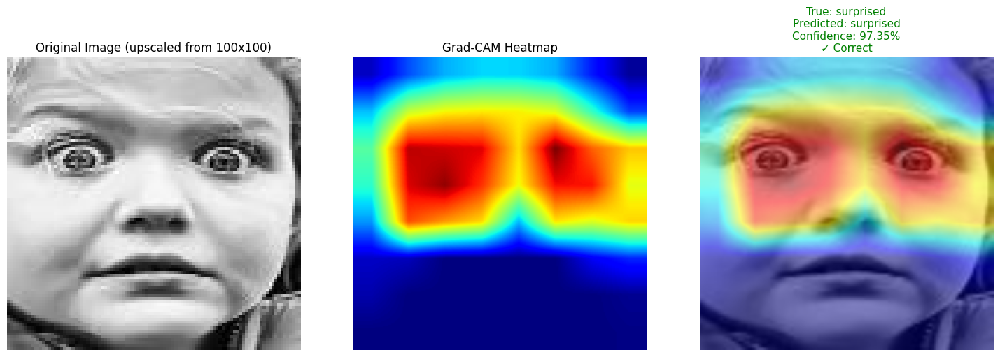


Final Result: surprised
Confidence: 97.35%


In [13]:
# Generate Grad-CAM for a test image
print("\n" + "=" * 60)
print("GENERATING GRAD-CAM VISUALIZATION")
print("=" * 60)

# Pick the first image from dataset
if len(dataset.images) > 0:
    test_image_path = dataset.images[5]
    true_label = dataset.labels[5]  # Get the ground truth label

    # Select target layer based on model type
    if USE_RESNET:
        # For ResNet50, use the last bottleneck block of layer4
        target_layer = model.resnet.layer4[-1]
        print("Using target layer: model.resnet.layer4[-1]")
    else:
        # For EmotionCNN, use conv4
        target_layer = model.conv4
        print("Using target layer: model.conv4")

    emotion, confidence, cam = generate_emotion_cam(
        model=model,
        image_path=test_image_path,
        emotion_names=list(dataset.emotion_map.values()),
        target_layer=target_layer,
        true_label=true_label,
    )

    print(f"\nFinal Result: {emotion}")
    print(f"Confidence: {confidence:.2%}")
else:
    print("No images found in dataset!")


GENERATING GRAD-CAM VISUALIZATIONS FOR ALL EMOTIONS
Using target layer: model.resnet.layer4[-1]

Finding example images for each emotion...
✓ Found examples for 7 emotions

EMOTION: SAD
True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 97.28%


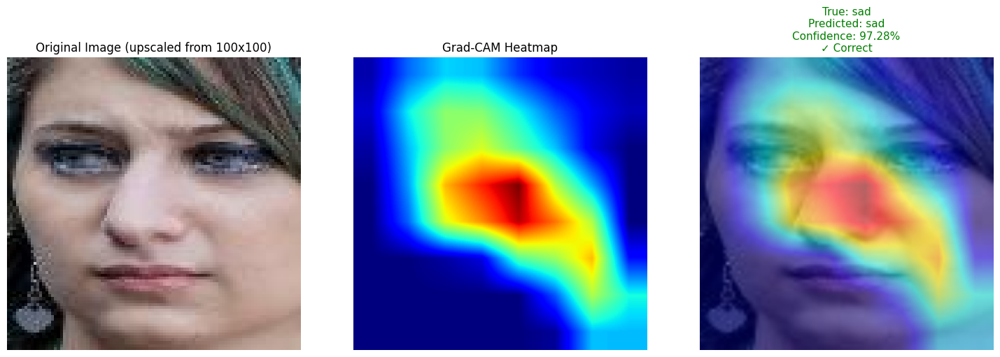


Image index: 0
Result: sad (97.3%)

EMOTION: HAPPY
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 100.00%


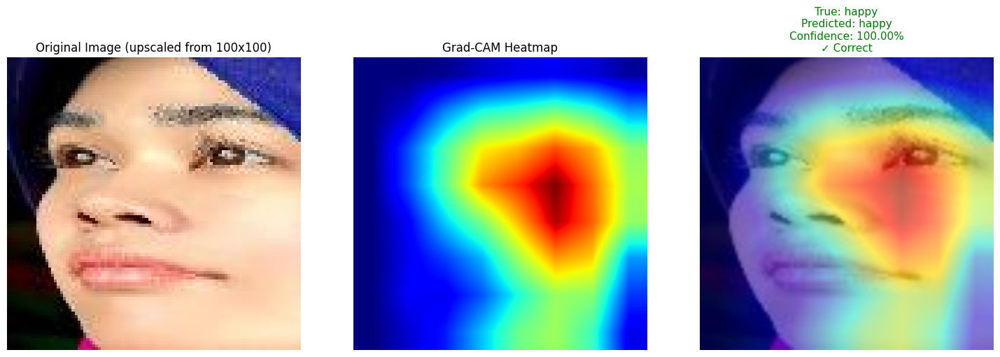


Image index: 2
Result: happy (100.0%)

EMOTION: SURPRISED
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 97.35%


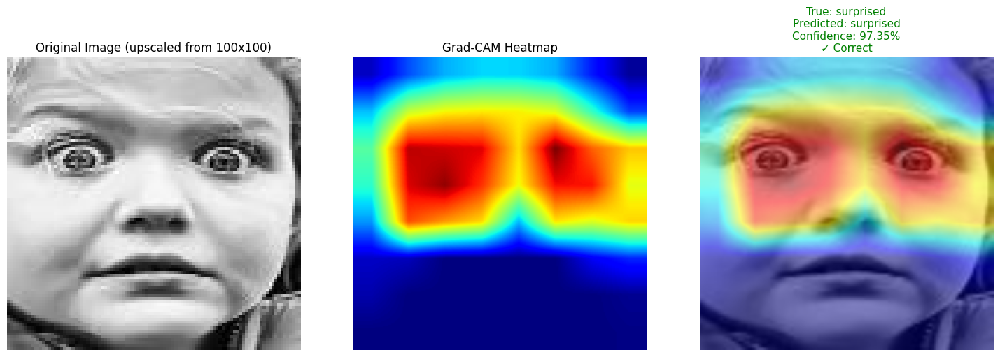


Image index: 5
Result: surprised (97.3%)

EMOTION: ANGRY
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 100.00%


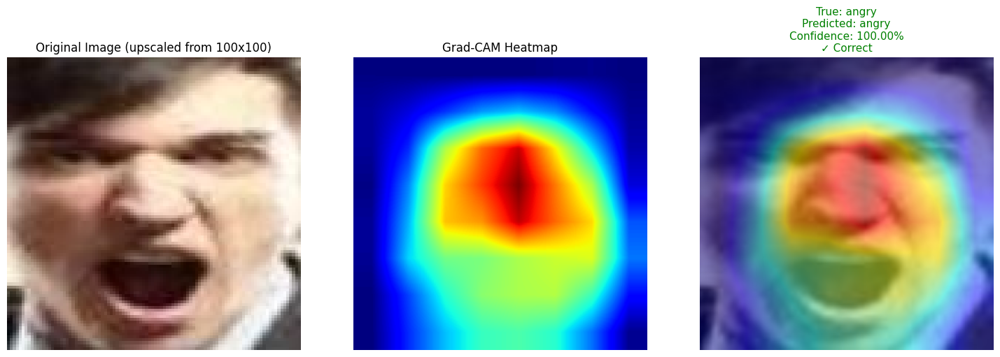


Image index: 22
Result: angry (100.0%)

EMOTION: FEARFUL
True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 99.83%


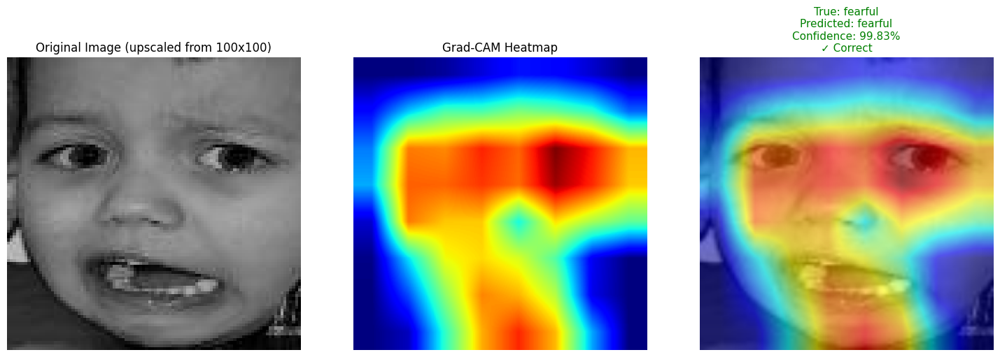


Image index: 26
Result: fearful (99.8%)

EMOTION: DISGUSTED
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 97.89%


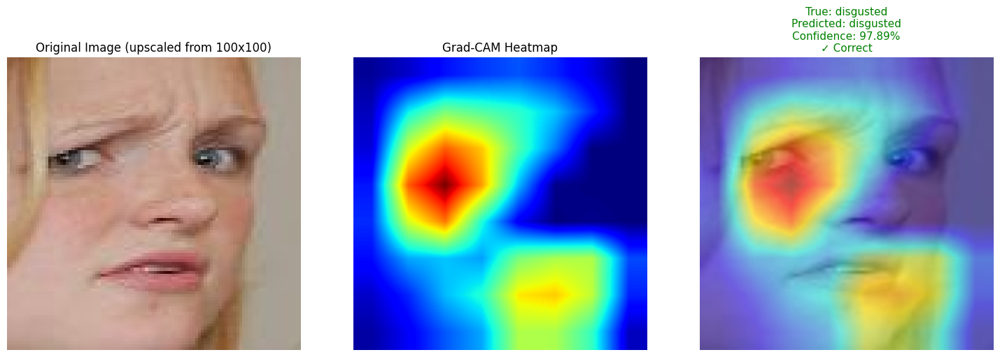


Image index: 30
Result: disgusted (97.9%)

EMOTION: NEUTRAL
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 99.98%


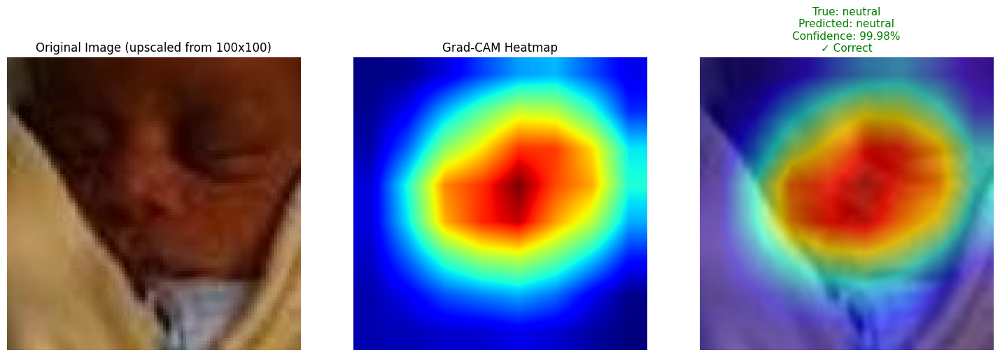


Image index: 9747
Result: neutral (100.0%)


SUMMARY OF ALL EMOTIONS
True Emotion    Predicted       Confidence   Status
------------------------------------------------------------
sad             sad             97.3%       ✓ Correct
happy           happy           100.0%      ✓ Correct
surprised       surprised       97.3%       ✓ Correct
angry           angry           100.0%      ✓ Correct
fearful         fearful         99.8%       ✓ Correct
disgusted       disgusted       97.9%       ✓ Correct
neutral         neutral         100.0%      ✓ Correct
------------------------------------------------------------
Accuracy on examples: 7/7 (100.0%)


In [15]:
# ============================================================================
# GENERATE GRAD-CAM VISUALIZATIONS FOR ALL 7 EMOTIONS
# ============================================================================

print("\n" + "=" * 60)
print("GENERATING GRAD-CAM VISUALIZATIONS FOR ALL EMOTIONS")
print("=" * 60)

# Select target layer
if USE_RESNET:
    target_layer = model.resnet.layer4[-1]
    print("Using target layer: model.resnet.layer4[-1]")
else:
    target_layer = model.conv4
    print("Using target layer: model.conv4")

# Dictionary to store one example per emotion
emotion_examples = {}

# Find one good example of each emotion (correct predictions preferred)
print("\nFinding example images for each emotion...")

for idx in range(len(dataset.images)):
    true_label = dataset.labels[idx]
    emotion_name = dataset.emotion_map[true_label]

    # If we don't have an example for this emotion yet, add it
    if emotion_name not in emotion_examples:
        emotion_examples[emotion_name] = {
            "image_path": dataset.images[idx],
            "true_label": true_label,
            "index": idx,
        }

    # Stop when we have all 7 emotions
    if len(emotion_examples) == 7:
        break

print(f"✓ Found examples for {len(emotion_examples)} emotions\n")

# Generate Grad-CAM for each emotion
results_summary = []

for emotion_name, example_info in emotion_examples.items():
    print("=" * 60)
    print(f"EMOTION: {emotion_name.upper()}")
    print("=" * 60)

    emotion, confidence, cam = generate_emotion_cam(
        model=model,
        image_path=example_info["image_path"],
        emotion_names=list(dataset.emotion_map.values()),
        target_layer=target_layer,
        true_label=example_info["true_label"],
    )

    # Store results
    results_summary.append(
        {
            "true_emotion": emotion_name,
            "predicted_emotion": emotion,
            "confidence": confidence,
            "correct": emotion == emotion_name,
        }
    )

    print(f"\nImage index: {example_info['index']}")
    print(f"Result: {emotion} ({confidence:.1%})")
    print()

# Print summary table
print("\n" + "=" * 60)
print("SUMMARY OF ALL EMOTIONS")
print("=" * 60)
print(f"{'True Emotion':<15} {'Predicted':<15} {'Confidence':<12} {'Status'}")
print("-" * 60)

for result in results_summary:
    status = "✓ Correct" if result["correct"] else "✗ Incorrect"
    print(
        f"{result['true_emotion']:<15} {result['predicted_emotion']:<15} {result['confidence']:<11.1%} {status}"
    )

# Calculate accuracy on these examples
correct_count = sum(1 for r in results_summary if r["correct"])
accuracy = correct_count / len(results_summary) * 100
print("-" * 60)
print(f"Accuracy on examples: {correct_count}/{len(results_summary)} ({accuracy:.1f}%)")

In [17]:
# HELPER: Browse your dataset to find good examples
print("=" * 60)
print("BROWSING DATASET TO FIND GOOD EXAMPLES")
print("=" * 60)

for emotion_idx, emotion_name in dataset.emotion_map.items():
    print(f"\n{emotion_name.upper()}:")
    print("-" * 40)

    # Find first 10 images of this emotion
    count = 0
    for idx, (img_path, label) in enumerate(zip(dataset.images, dataset.labels)):
        if label == emotion_idx and count < 10:
            print(f"  Index {idx}: {os.path.basename(img_path)}")
            count += 1

    if count == 0:
        print(f"  No examples found!")

print("\n" + "=" * 60)
print("Copy the indices you want into the best_examples dictionary above")

BROWSING DATASET TO FIND GOOD EXAMPLES

SURPRISED:
----------------------------------------
  Index 5: train_00006_aligned.jpg
  Index 9: train_00010_aligned.jpg
  Index 11: train_00012_aligned.jpg
  Index 12: train_00013_aligned.jpg
  Index 31: train_00032_aligned.jpg
  Index 33: train_00034_aligned.jpg
  Index 42: train_00043_aligned.jpg
  Index 43: train_00044_aligned.jpg
  Index 52: train_00053_aligned.jpg
  Index 61: train_00062_aligned.jpg

FEARFUL:
----------------------------------------
  Index 26: train_00027_aligned.jpg
  Index 613: train_00614_aligned.jpg
  Index 778: train_00779_aligned.jpg
  Index 1156: train_01157_aligned.jpg
  Index 1177: train_01178_aligned.jpg
  Index 2039: train_02040_aligned.jpg
  Index 2836: train_02837_aligned.jpg
  Index 3351: train_03352_aligned.jpg
  Index 4560: train_04561_aligned.jpg
  Index 5171: train_05172_aligned.jpg

DISGUSTED:
----------------------------------------
  Index 30: train_00031_aligned.jpg
  Index 62: train_00063_aligned.jp

Auto-selecting high-quality examples...


True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 97.28%


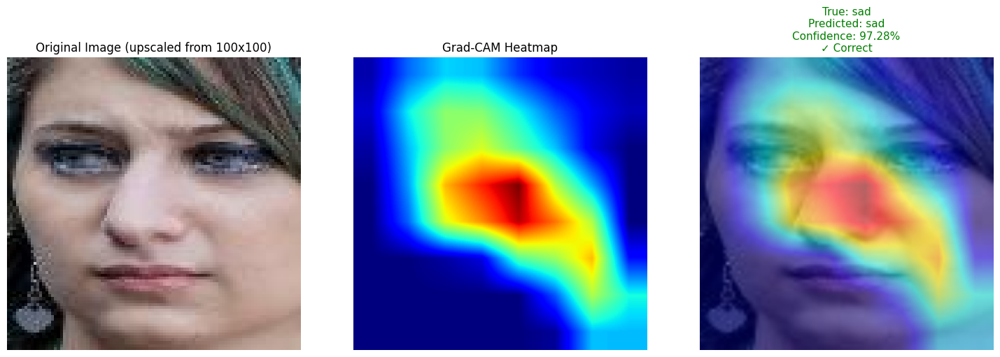

✓ sad: Index 0 (97.3% confidence)
True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 99.96%


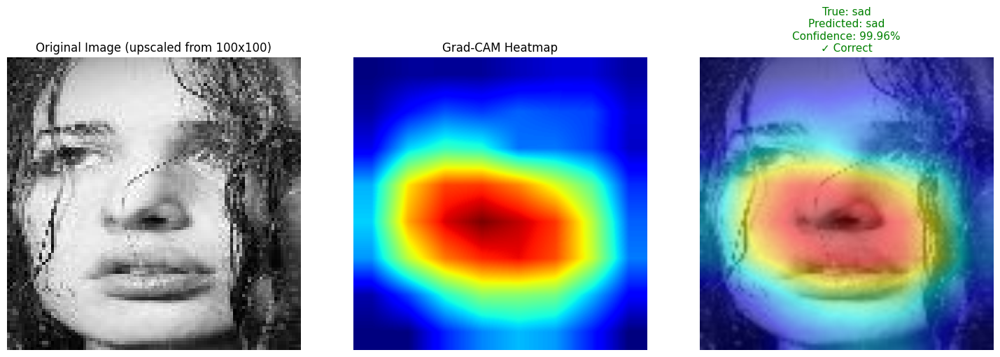

✓ sad: Index 1 (100.0% confidence)
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 100.00%


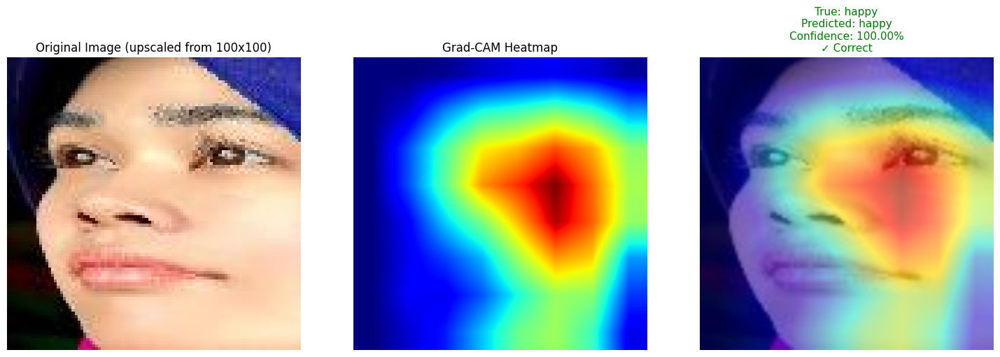

✓ happy: Index 2 (100.0% confidence)
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 99.99%


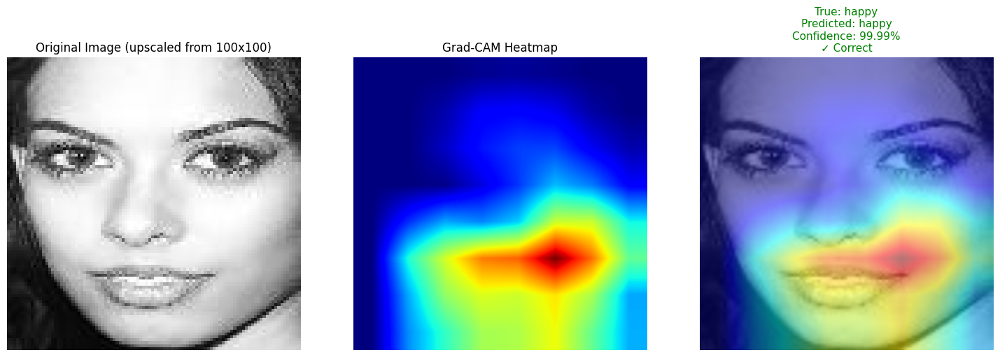

✓ happy: Index 3 (100.0% confidence)
True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 99.04%


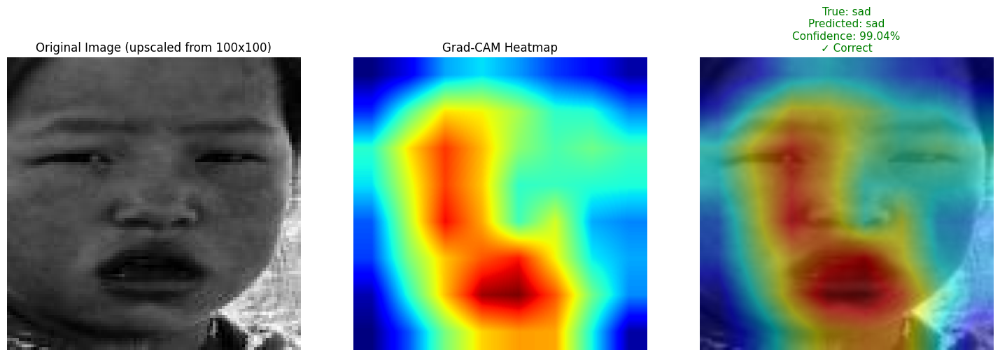

✓ sad: Index 4 (99.0% confidence)
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 97.35%


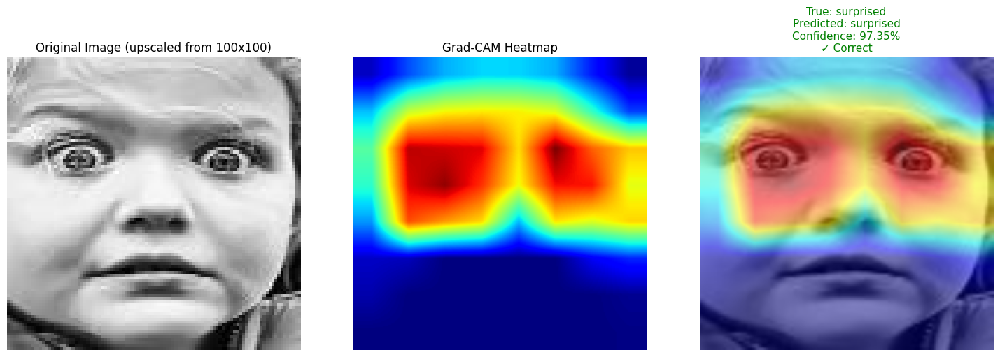

✓ surprised: Index 5 (97.3% confidence)
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 77.99%


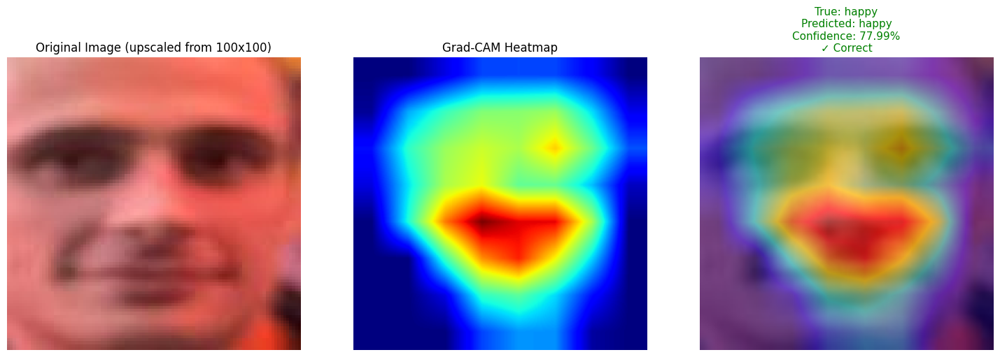

True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 94.76%


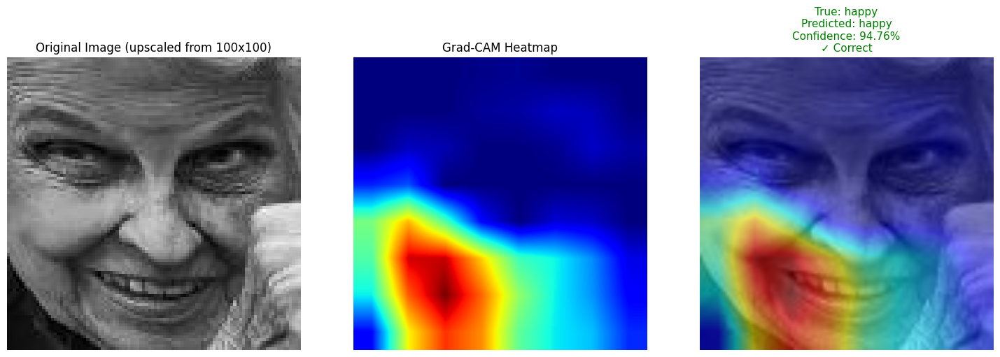

✓ happy: Index 8 (94.8% confidence)
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 99.83%


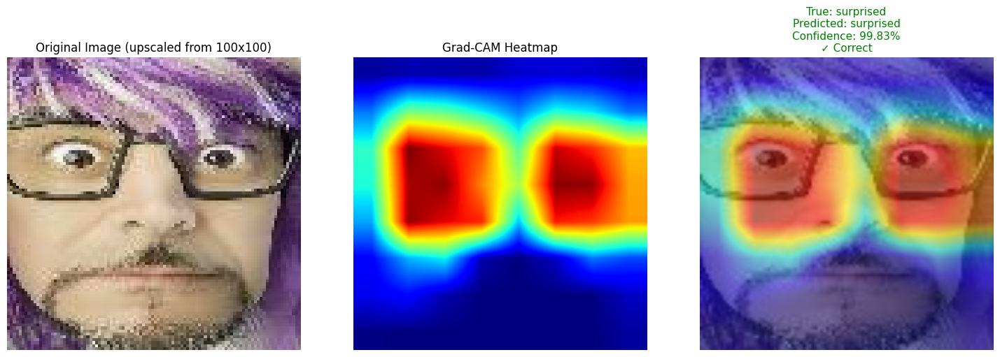

✓ surprised: Index 9 (99.8% confidence)
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 100.00%


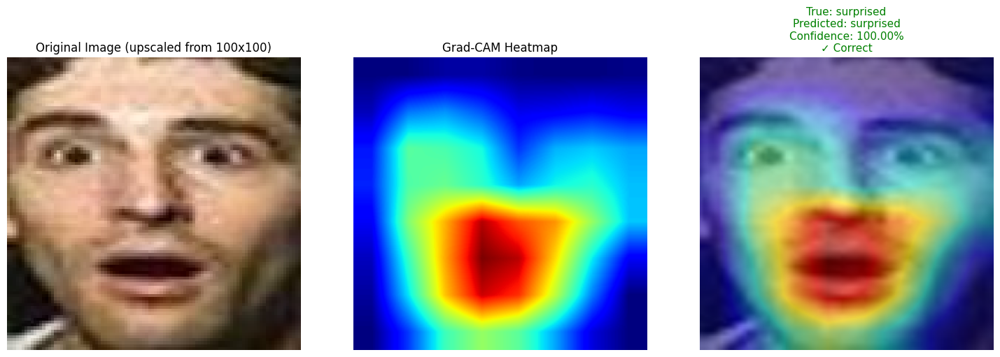

✓ surprised: Index 11 (100.0% confidence)
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 100.00%


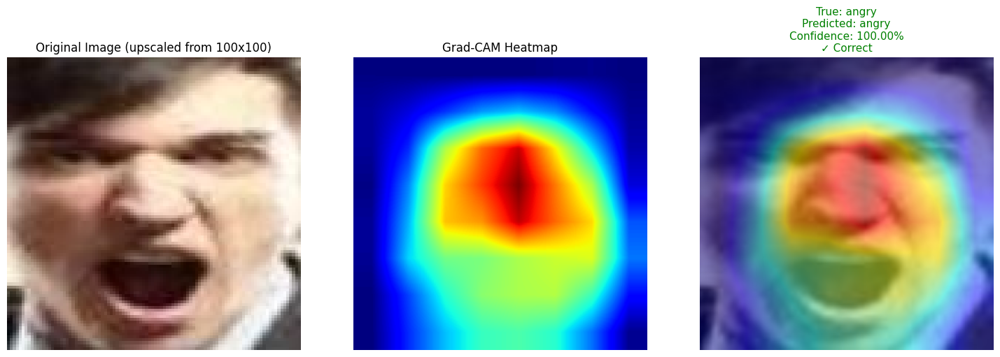

✓ angry: Index 22 (100.0% confidence)
True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 99.83%


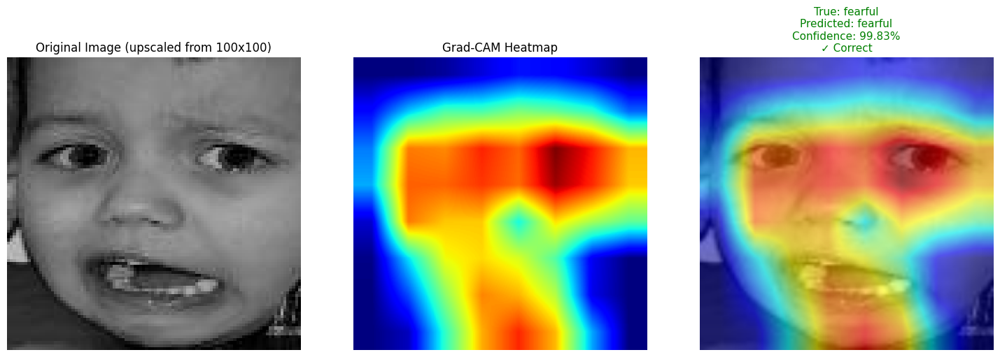

✓ fearful: Index 26 (99.8% confidence)
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 97.89%


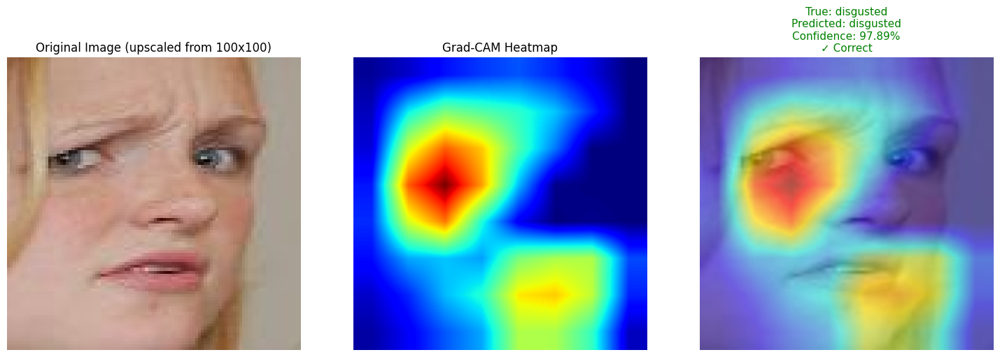

✓ disgusted: Index 30 (97.9% confidence)
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 99.83%


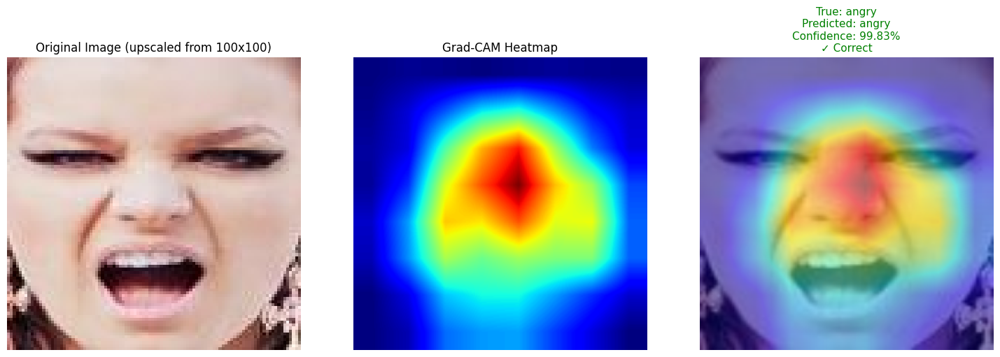

✓ angry: Index 46 (99.8% confidence)
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 99.25%


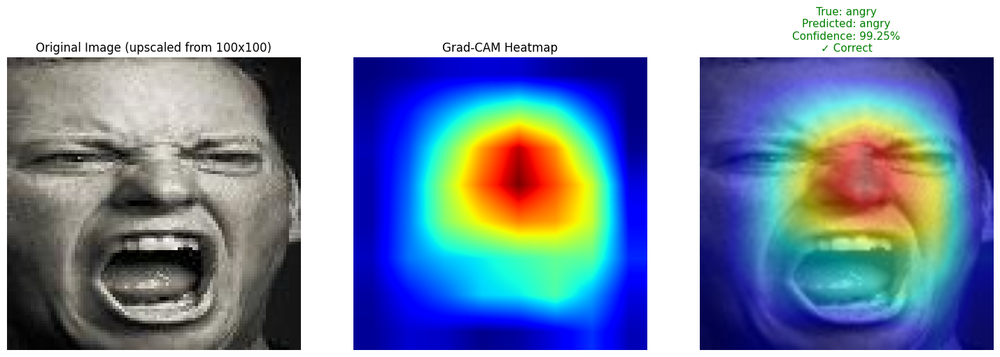

✓ angry: Index 48 (99.2% confidence)
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 87.72%


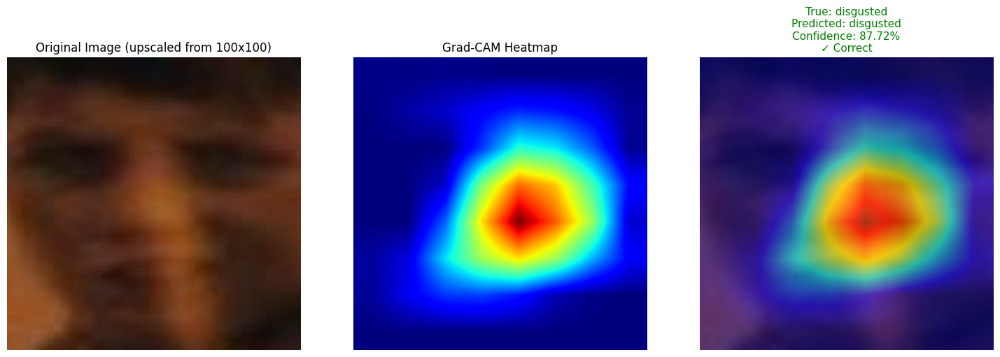

✓ disgusted: Index 62 (87.7% confidence)
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 94.66%


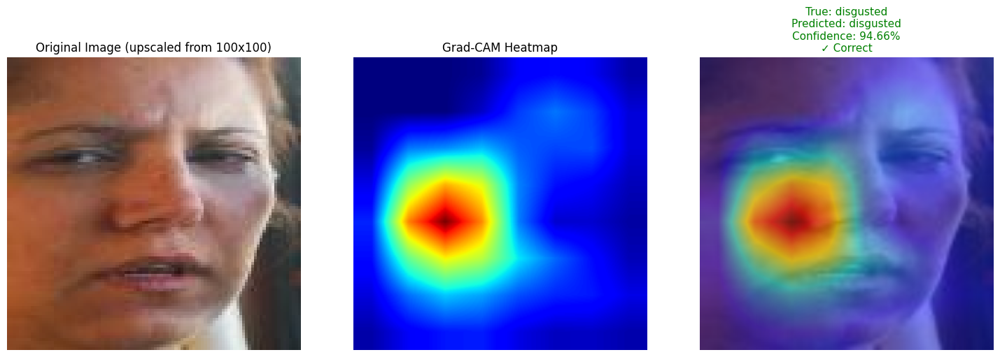

✓ disgusted: Index 70 (94.7% confidence)
True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 99.99%


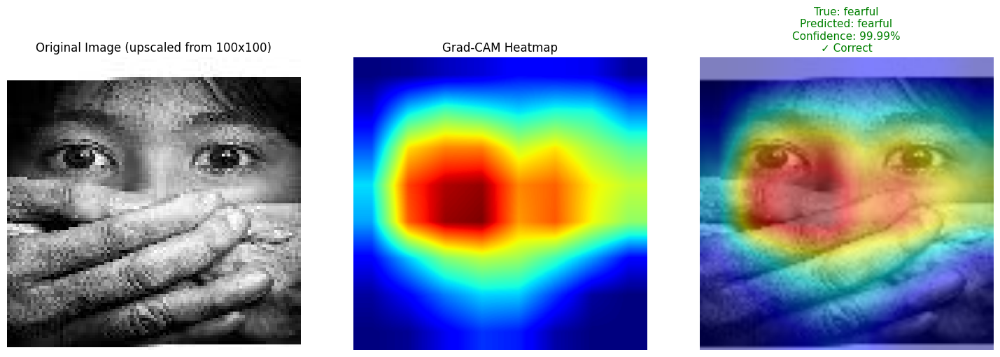

✓ fearful: Index 613 (100.0% confidence)
True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 92.55%


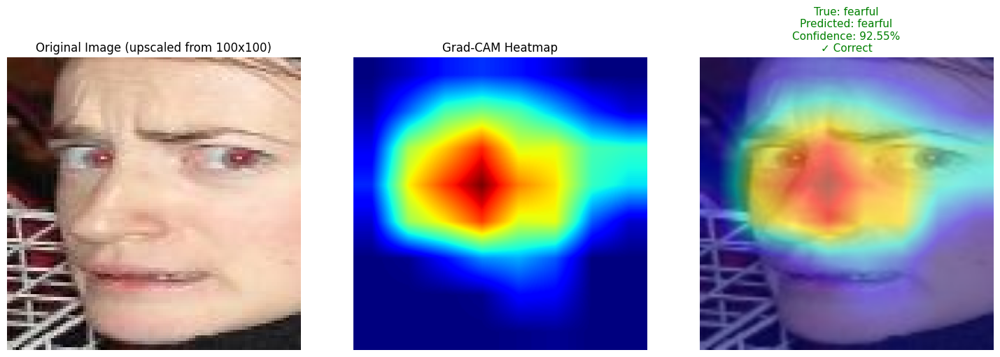

✓ fearful: Index 778 (92.6% confidence)
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 99.98%


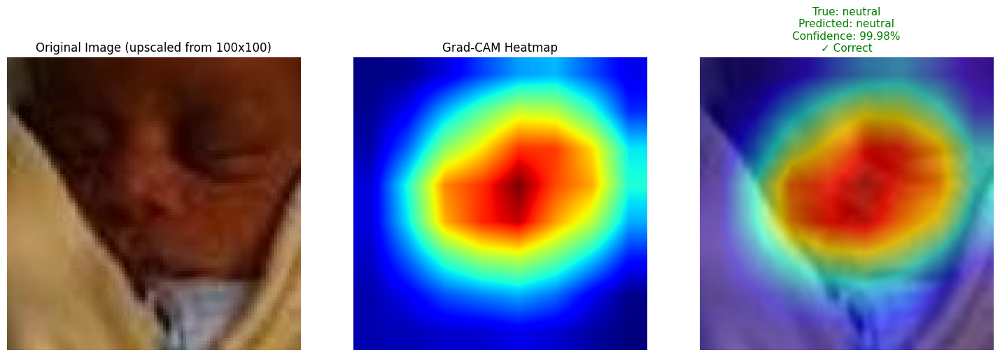

✓ neutral: Index 9747 (100.0% confidence)
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 87.73%


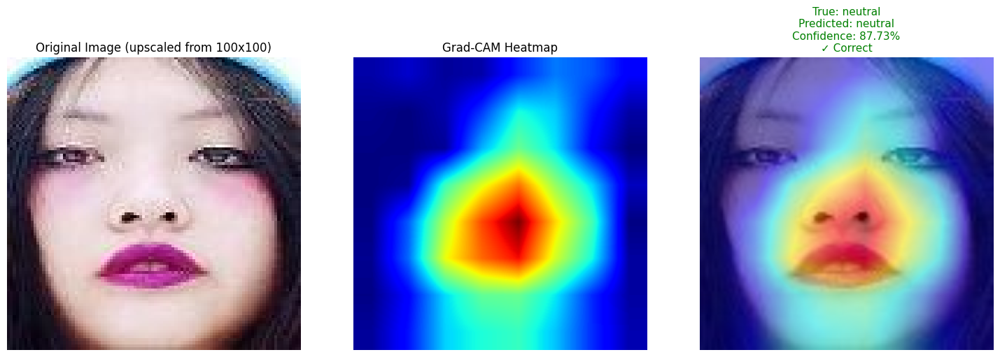

✓ neutral: Index 9748 (87.7% confidence)
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 73.61%


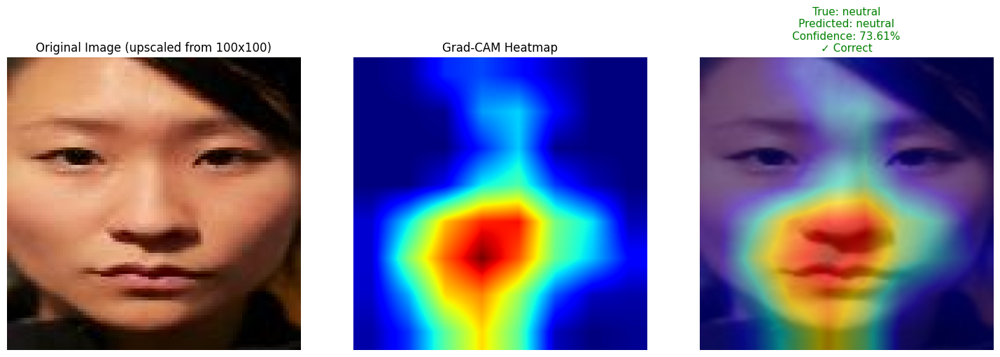

True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 95.19%


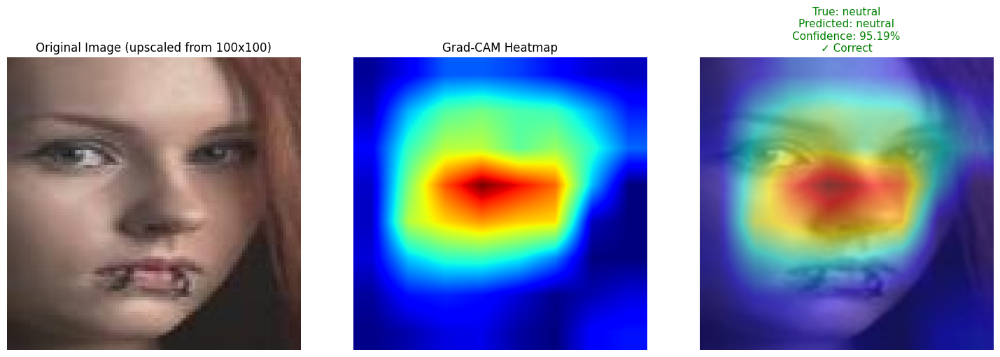

✓ neutral: Index 9750 (95.2% confidence)

✓ Auto-selected examples saved!


In [25]:
import shutil

# Automatically find high-quality examples (correct + high confidence)
print("Auto-selecting high-quality examples...")

if USE_RESNET:
    target_layer = model.resnet.layer4[-1]
else:
    target_layer = model.conv4

auto_selected = {emotion: [] for emotion in dataset.emotion_map.values()}
MAX_PER_EMOTION = 3

for idx in range(len(dataset.images)):
    true_label = dataset.labels[idx]
    emotion_name = dataset.emotion_map[true_label]

    # Skip if we have enough for this emotion
    if len(auto_selected[emotion_name]) >= MAX_PER_EMOTION:
        continue

    # Quick prediction
    emotion, confidence, _ = generate_emotion_cam(
        model=model,
        image_path=dataset.images[idx],
        emotion_names=list(dataset.emotion_map.values()),
        target_layer=target_layer,
        true_label=true_label,
    )

    # Only save if correct AND high confidence
    if emotion == emotion_name and confidence > 0.80:
        auto_selected[emotion_name].append(idx)
        print(f"✓ {emotion_name}: Index {idx} ({confidence:.1%} confidence)")

    # Stop when we have enough for all emotions
    if all(len(examples) >= MAX_PER_EMOTION for examples in auto_selected.values()):
        break

# Now save these auto-selected examples
for emotion_name, indices in auto_selected.items():
    for i, idx in enumerate(indices, 1):
        src_path = dataset.images[idx]
        dst_path = f"viz_examples/{emotion_name}/example{i}.jpg"
        shutil.copy(src_path, dst_path)

print("\n✓ Auto-selected examples saved!")

AUTO-SELECTING HIGH-QUALITY EXAMPLES FROM TEST SET
Loaded 3068 entries from CSV
Loaded 3068 test images

Created directory: viz_examples/surprised/
Created directory: viz_examples/fearful/
Created directory: viz_examples/disgusted/
Created directory: viz_examples/happy/
Created directory: viz_examples/sad/
Created directory: viz_examples/angry/
Created directory: viz_examples/neutral/

Searching TEST set for examples (>70% confidence)...

True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 99.96%


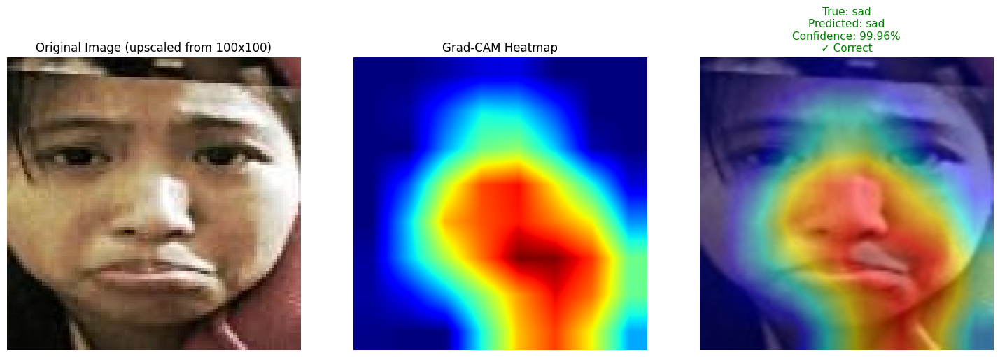

✓ sad          - Index     0 - 100.0% confidence - TEST SET
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 95.54%


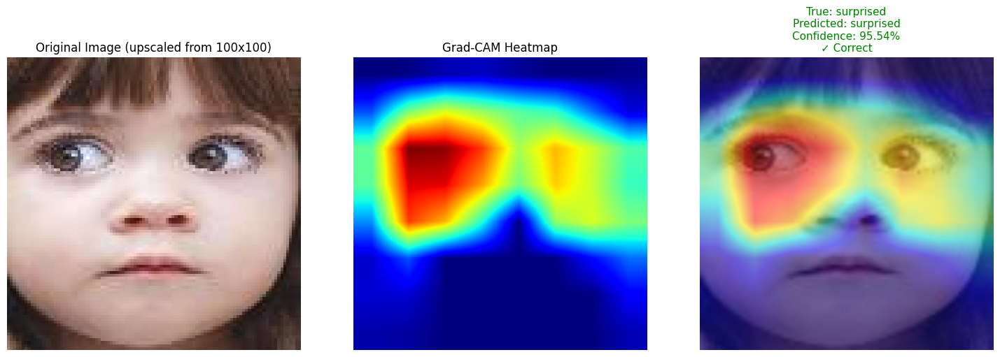

✓ surprised    - Index     1 - 95.5% confidence - TEST SET
True emotion: happy (index: 3)
Predicted emotion: neutral (index: 6)
Correct: ✗
Confidence: 58.52%


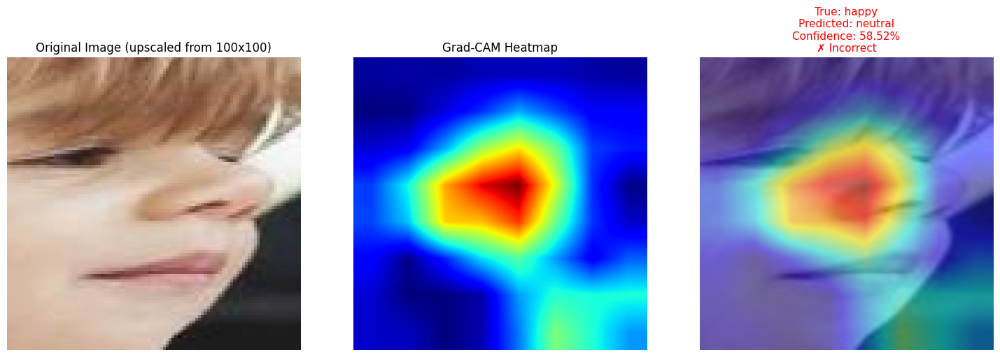

True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 99.81%


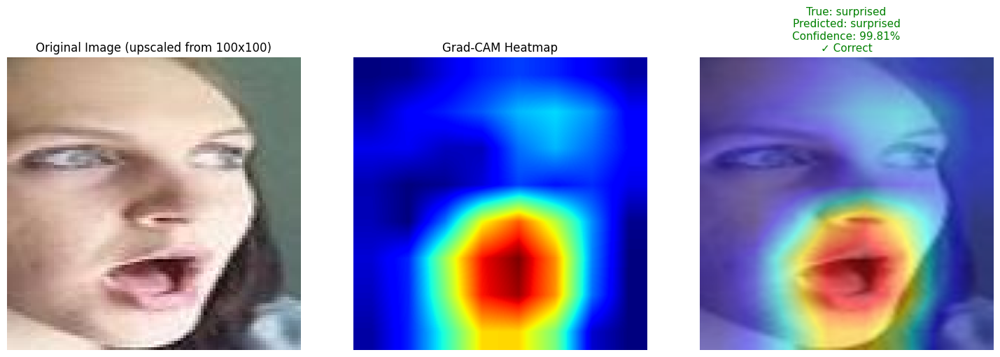

✓ surprised    - Index     3 - 99.8% confidence - TEST SET
True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 99.99%


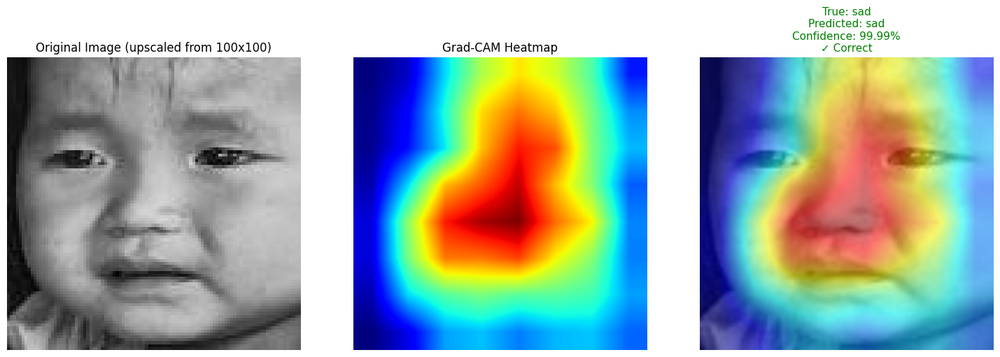

✓ sad          - Index     4 - 100.0% confidence - TEST SET
True emotion: sad (index: 4)
Predicted emotion: sad (index: 4)
Correct: ✓
Confidence: 99.48%


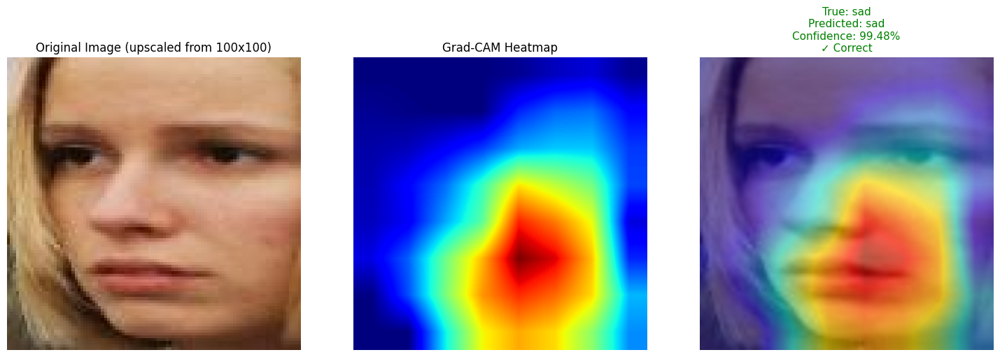

✓ sad          - Index     5 - 99.5% confidence - TEST SET
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 99.52%


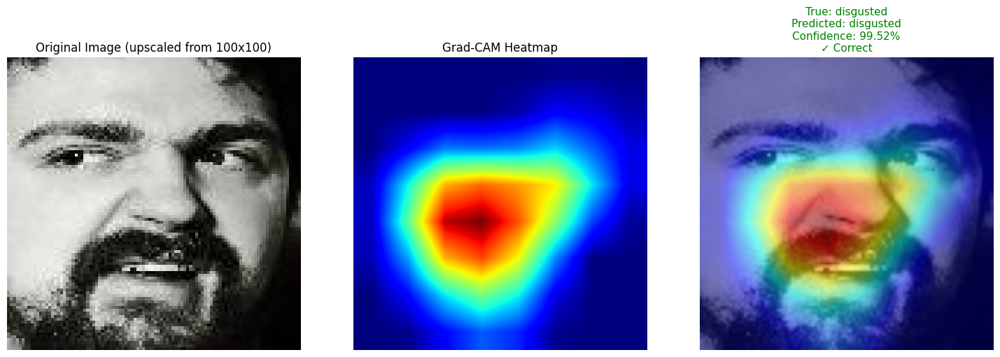

✓ disgusted    - Index     6 - 99.5% confidence - TEST SET
True emotion: surprised (index: 0)
Predicted emotion: surprised (index: 0)
Correct: ✓
Confidence: 100.00%


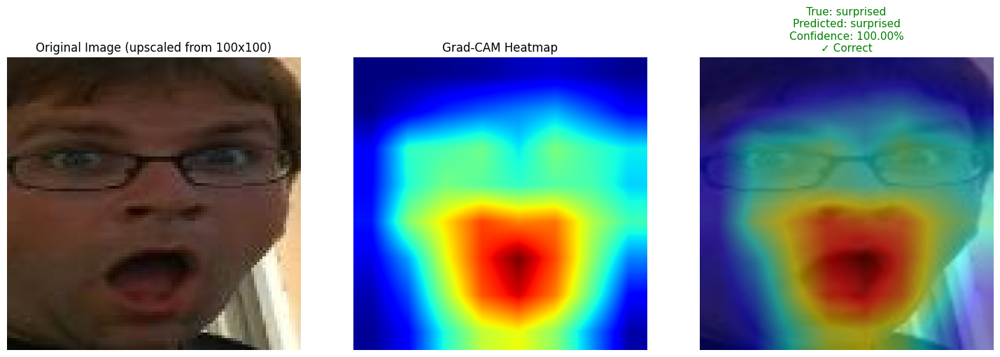

✓ surprised    - Index     7 - 100.0% confidence - TEST SET
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 95.67%


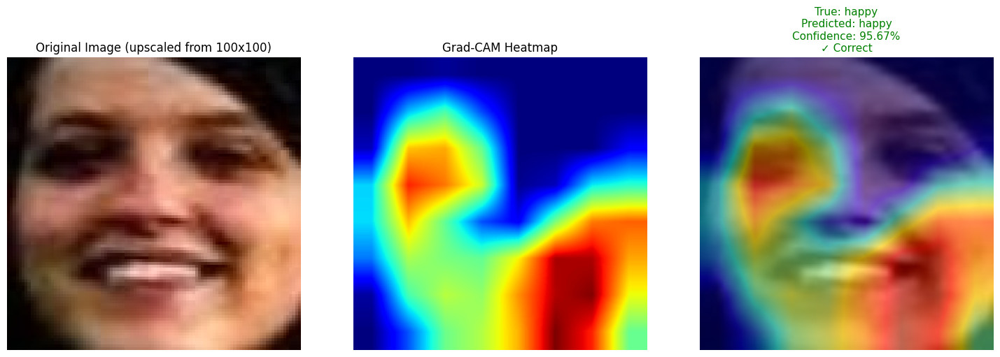

✓ happy        - Index     8 - 95.7% confidence - TEST SET
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 95.95%


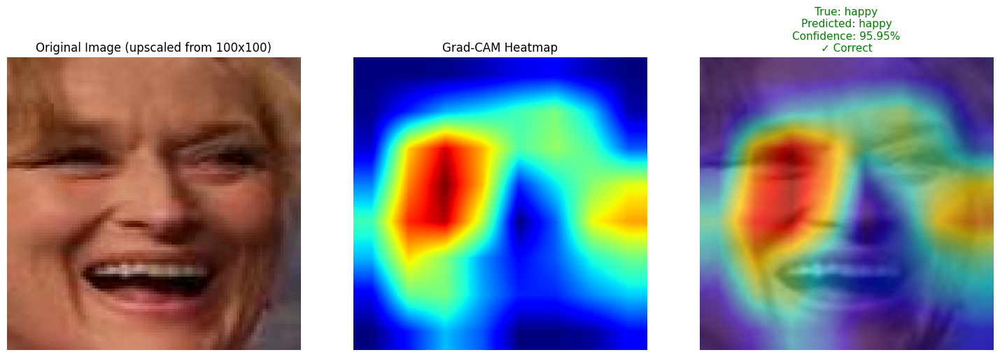

✓ happy        - Index     9 - 96.0% confidence - TEST SET
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 99.98%


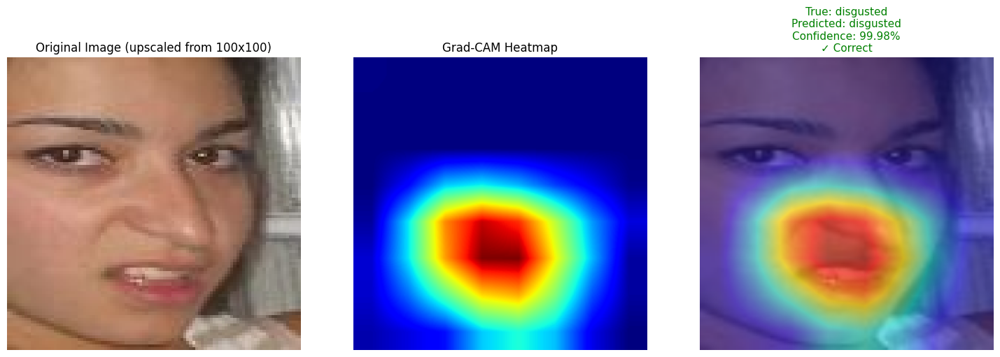

✓ disgusted    - Index    10 - 100.0% confidence - TEST SET
True emotion: happy (index: 3)
Predicted emotion: happy (index: 3)
Correct: ✓
Confidence: 100.00%


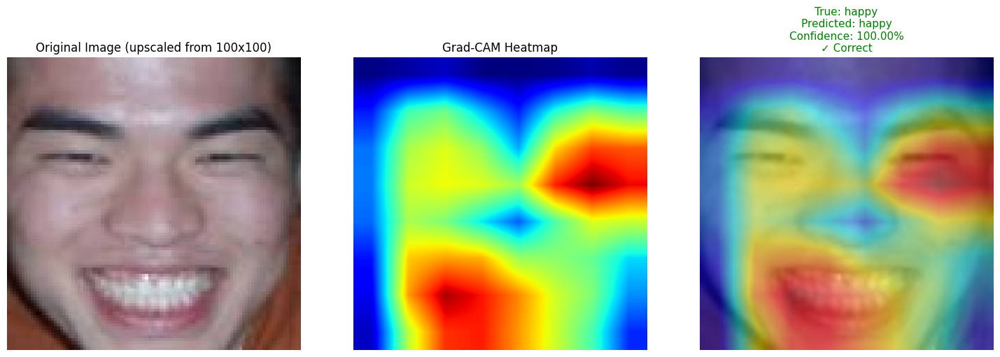

✓ happy        - Index    11 - 100.0% confidence - TEST SET
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 99.95%


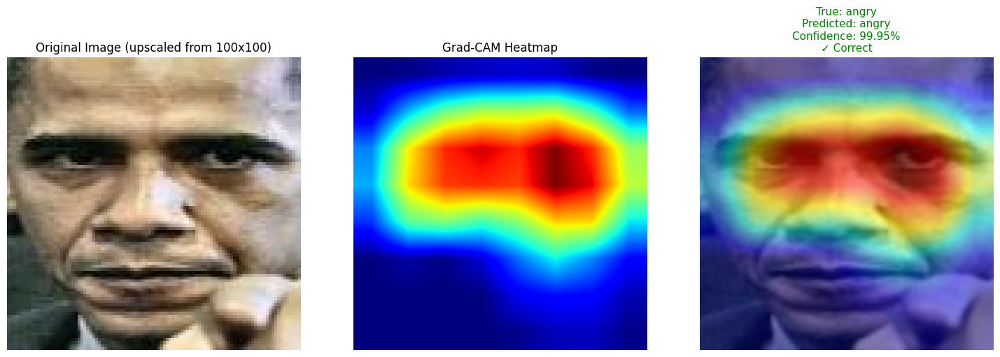

✓ angry        - Index    16 - 100.0% confidence - TEST SET
True emotion: disgusted (index: 2)
Predicted emotion: disgusted (index: 2)
Correct: ✓
Confidence: 87.94%


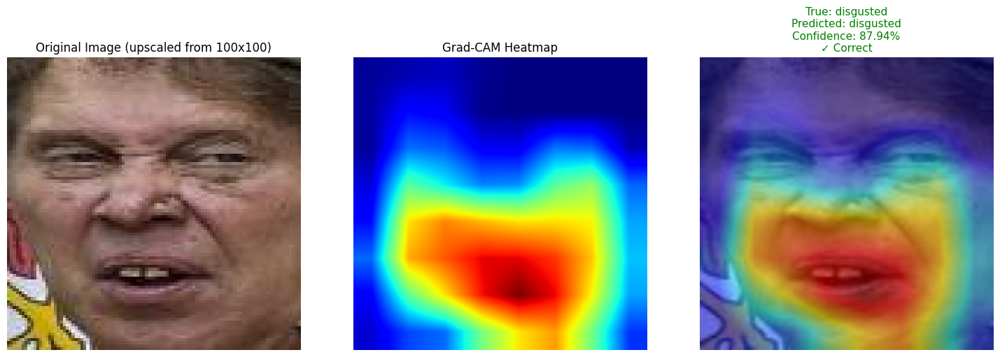

✓ disgusted    - Index    17 - 87.9% confidence - TEST SET
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 99.98%


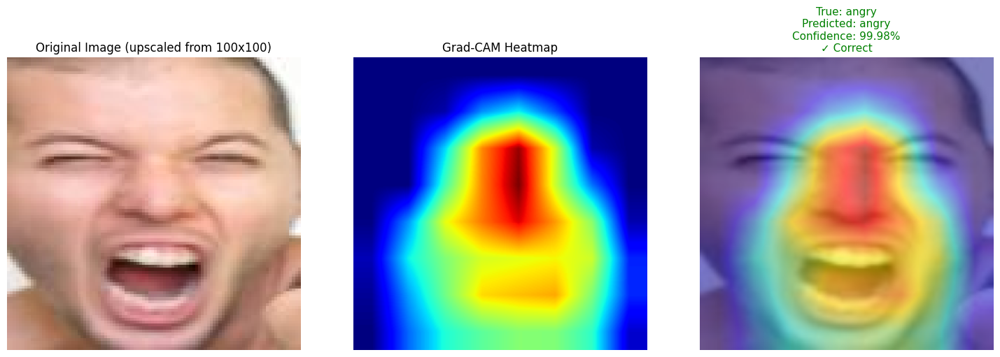

✓ angry        - Index    26 - 100.0% confidence - TEST SET
True emotion: angry (index: 5)
Predicted emotion: angry (index: 5)
Correct: ✓
Confidence: 100.00%


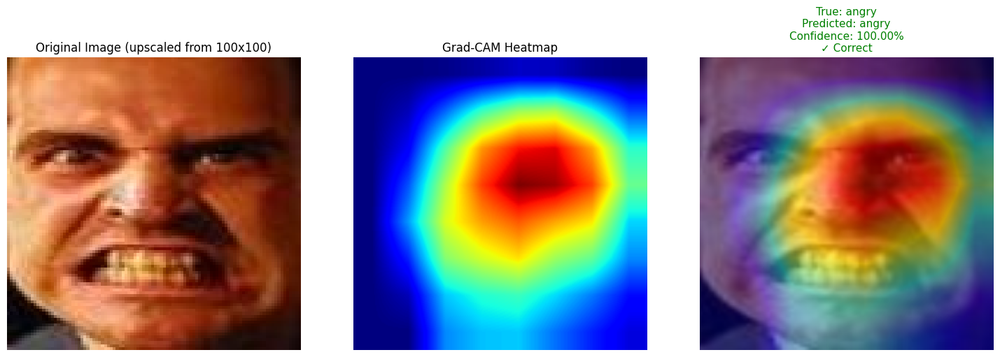

✓ angry        - Index    36 - 100.0% confidence - TEST SET
True emotion: fearful (index: 1)
Predicted emotion: sad (index: 4)
Correct: ✗
Confidence: 98.26%


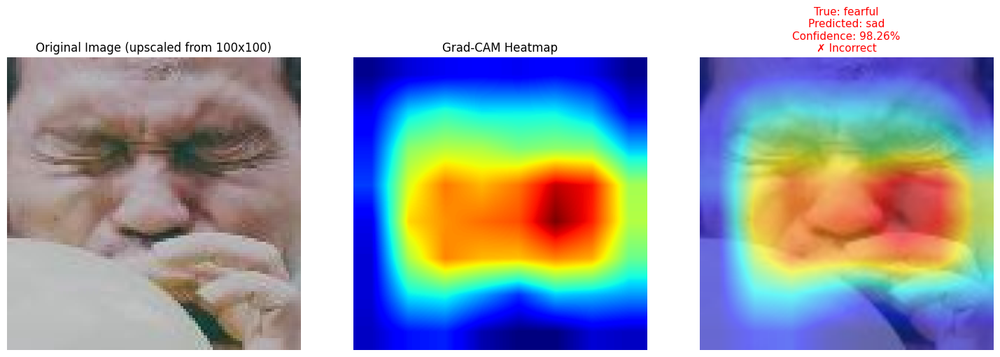

True emotion: fearful (index: 1)
Predicted emotion: sad (index: 4)
Correct: ✗
Confidence: 40.51%


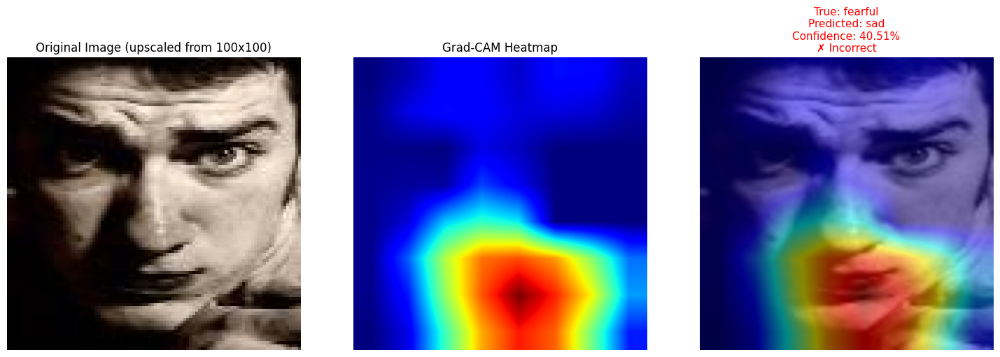

True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 100.00%


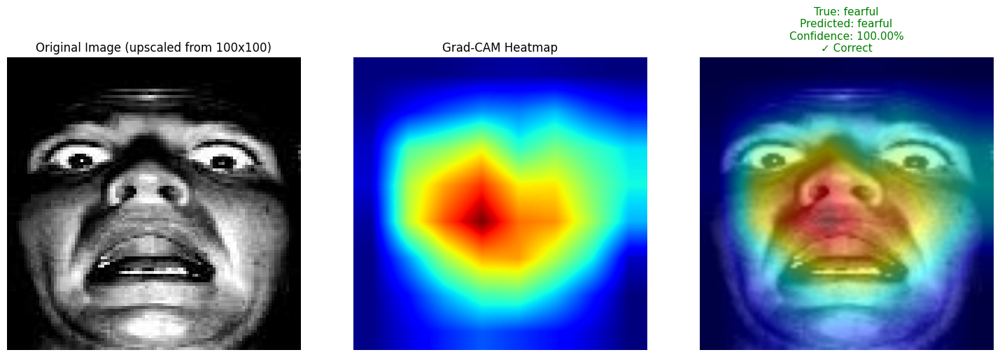

✓ fearful      - Index   622 - 100.0% confidence - TEST SET
True emotion: fearful (index: 1)
Predicted emotion: surprised (index: 0)
Correct: ✗
Confidence: 89.36%


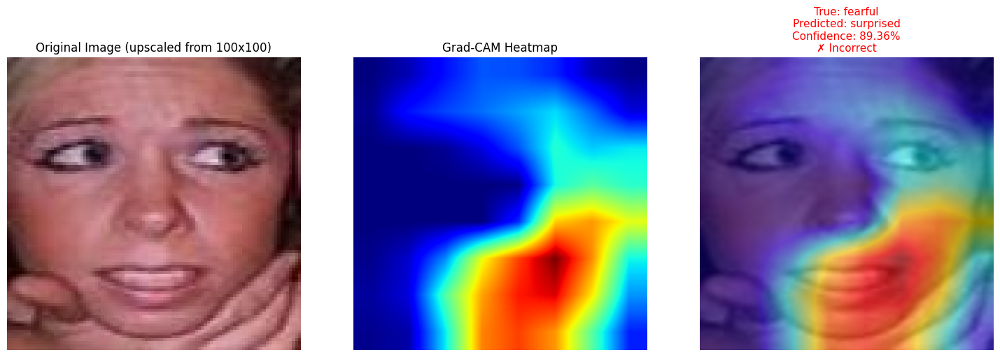

True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 90.98%


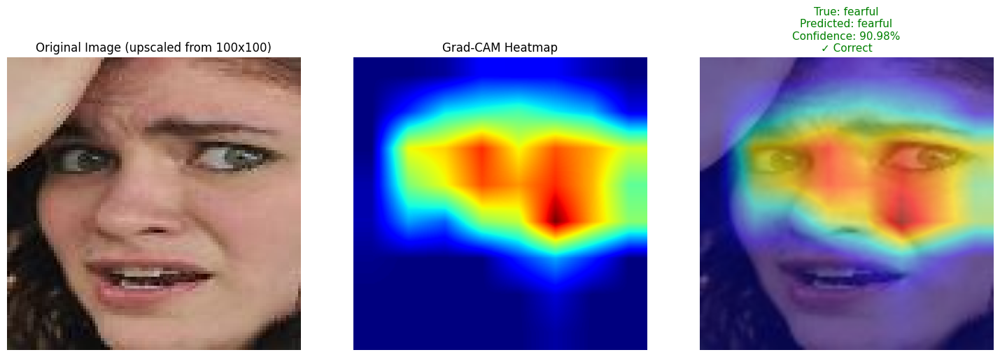

✓ fearful      - Index  1476 - 91.0% confidence - TEST SET
True emotion: fearful (index: 1)
Predicted emotion: neutral (index: 6)
Correct: ✗
Confidence: 44.88%


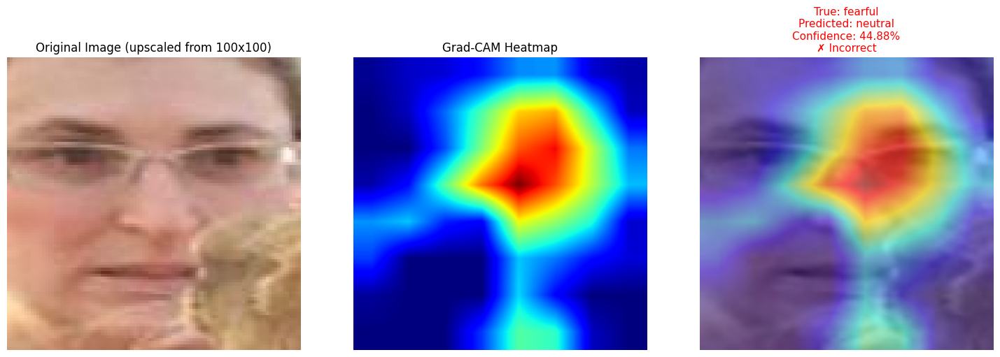

True emotion: fearful (index: 1)
Predicted emotion: fearful (index: 1)
Correct: ✓
Confidence: 100.00%


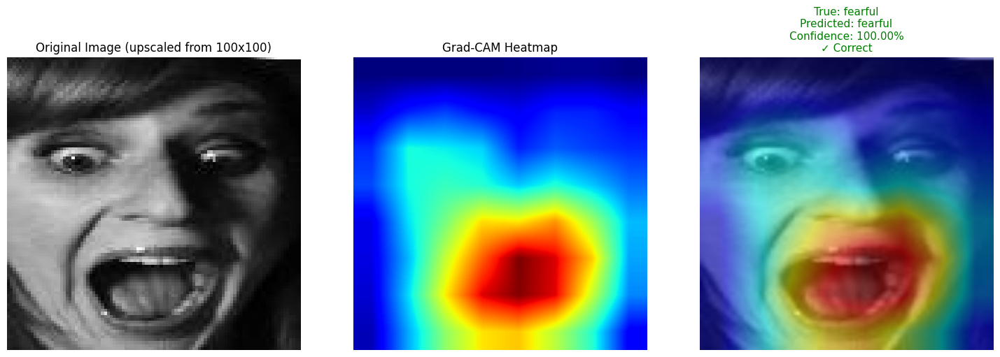

✓ fearful      - Index  1787 - 100.0% confidence - TEST SET
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 99.88%


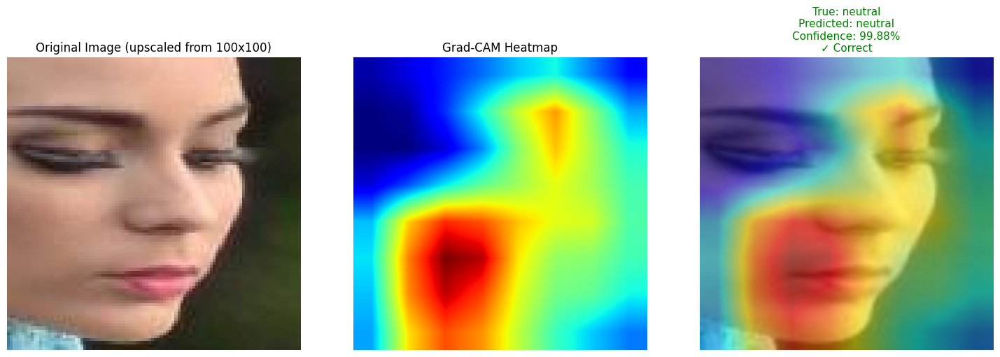

✓ neutral      - Index  2388 - 99.9% confidence - TEST SET
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 97.17%


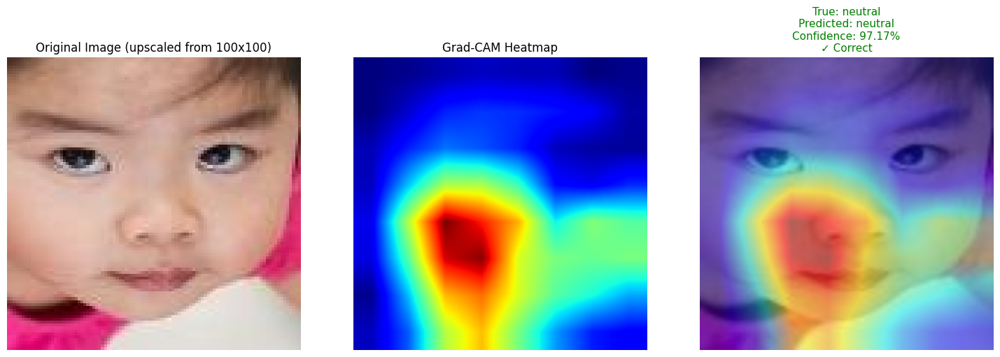

✓ neutral      - Index  2389 - 97.2% confidence - TEST SET
True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 56.96%


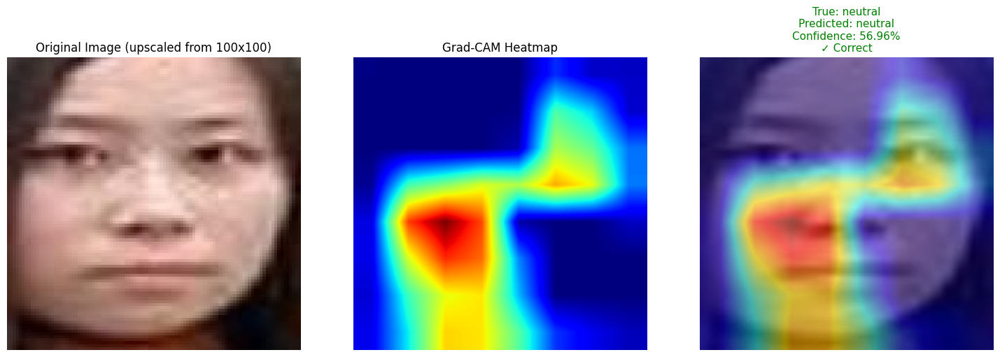

True emotion: neutral (index: 6)
Predicted emotion: neutral (index: 6)
Correct: ✓
Confidence: 99.95%


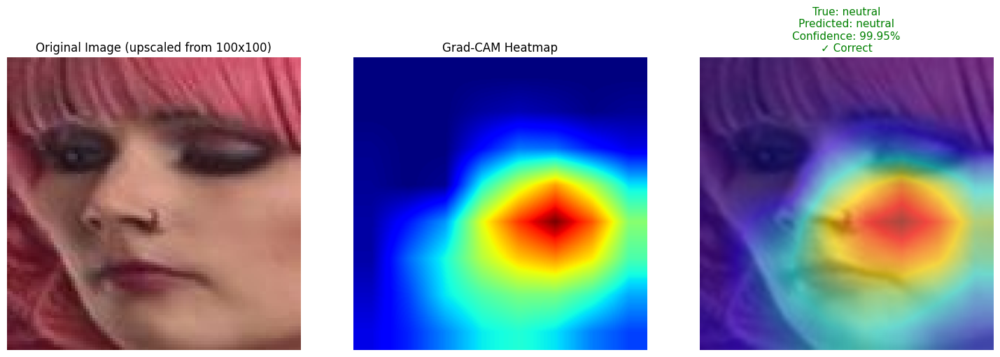

✓ neutral      - Index  2391 - 100.0% confidence - TEST SET

✓ Found 3 examples for each emotion from test set!

SAVING TEST SET EXAMPLES TO viz_examples/ FOLDER
✓ Saved: viz_examples/surprised/example1.jpg
✓ Saved: viz_examples/surprised/example2.jpg
✓ Saved: viz_examples/surprised/example3.jpg
✓ Saved: viz_examples/fearful/example1.jpg
✓ Saved: viz_examples/fearful/example2.jpg
✓ Saved: viz_examples/fearful/example3.jpg
✓ Saved: viz_examples/disgusted/example1.jpg
✓ Saved: viz_examples/disgusted/example2.jpg
✓ Saved: viz_examples/disgusted/example3.jpg
✓ Saved: viz_examples/happy/example1.jpg
✓ Saved: viz_examples/happy/example2.jpg
✓ Saved: viz_examples/happy/example3.jpg
✓ Saved: viz_examples/sad/example1.jpg
✓ Saved: viz_examples/sad/example2.jpg
✓ Saved: viz_examples/sad/example3.jpg
✓ Saved: viz_examples/angry/example1.jpg
✓ Saved: viz_examples/angry/example2.jpg
✓ Saved: viz_examples/angry/example3.jpg
✓ Saved: viz_examples/neutral/example1.jpg
✓ Saved: viz_examples/neutral/exa

In [28]:
import os
import shutil

# ============================================================================
# AUTO-SELECT TEST SET EXAMPLES FOR STREAMLIT
# ============================================================================

print("=" * 60)
print("AUTO-SELECTING HIGH-QUALITY EXAMPLES FROM TEST SET")
print("=" * 60)

# CHANGE TO TEST SET
DATA_DIR = "data/RAF-DB/DATASET/test"  # Test folder
LABELS_FILE = "data/RAF-DB/test_labels.csv"  # Test labels

# Load TEST dataset
train_transform, val_transform = get_data_transforms()
test_dataset = RAFDBDataset(
    DATA_DIR, LABELS_FILE, transform=val_transform
)  # Use val_transform for test

print(f"Loaded {len(test_dataset)} test images\n")

# Create viz_examples directory structure
base_dir = "viz_examples"
for emotion in test_dataset.emotion_map.values():
    emotion_dir = os.path.join(base_dir, emotion)
    os.makedirs(emotion_dir, exist_ok=True)
    print(f"Created directory: {emotion_dir}/")

# Set target layer
if USE_RESNET:
    target_layer = model.resnet.layer4[-1]
else:
    target_layer = model.conv4

# Auto-select high-quality examples from TEST set
auto_selected = {emotion: [] for emotion in test_dataset.emotion_map.values()}
MAX_PER_EMOTION = 3  # 3 examples per emotion
MIN_CONFIDENCE = 0.70  # Lower threshold for test set (more realistic)

print(f"\nSearching TEST set for examples (>{MIN_CONFIDENCE:.0%} confidence)...\n")

for idx in range(len(test_dataset.images)):
    true_label = test_dataset.labels[idx]
    emotion_name = test_dataset.emotion_map[true_label]

    # Skip if we have enough for this emotion
    if len(auto_selected[emotion_name]) >= MAX_PER_EMOTION:
        continue

    # Generate Grad-CAM and get prediction
    emotion, confidence, _ = generate_emotion_cam(
        model=model,
        image_path=test_dataset.images[idx],
        emotion_names=list(test_dataset.emotion_map.values()),
        target_layer=target_layer,
        true_label=true_label,
    )

    # Only save if correct AND meets confidence threshold
    if emotion == emotion_name and confidence > MIN_CONFIDENCE:
        auto_selected[emotion_name].append(idx)
        print(
            f"✓ {emotion_name:12} - Index {idx:5} - {confidence:.1%} confidence - TEST SET"
        )

    # Stop when we have enough for all emotions
    if all(len(examples) >= MAX_PER_EMOTION for examples in auto_selected.values()):
        print(f"\n✓ Found {MAX_PER_EMOTION} examples for each emotion from test set!")
        break

# Save the selected examples
print("\n" + "=" * 60)
print("SAVING TEST SET EXAMPLES TO viz_examples/ FOLDER")
print("=" * 60)

for emotion_name, indices in auto_selected.items():
    if len(indices) == 0:
        print(f"⚠ Warning: No examples found for {emotion_name} in test set")
        print(f"  Consider lowering MIN_CONFIDENCE or checking test data")
    else:
        for i, idx in enumerate(indices, 1):
            src_path = test_dataset.images[idx]
            dst_path = os.path.join(base_dir, emotion_name, f"example{i}.jpg")

            # Verify source exists
            if os.path.exists(src_path):
                shutil.copy(src_path, dst_path)
                print(f"✓ Saved: {dst_path}")
            else:
                print(f"⚠ Source file not found: {src_path}")

# Print final summary
print("\n" + "=" * 60)
print("✅ TEST SET EXAMPLES READY!")
print("=" * 60)

print("\nSaved examples (from TEST set):")
total_saved = 0
for emotion in test_dataset.emotion_map.values():
    example_dir = os.path.join(base_dir, emotion)
    if os.path.exists(example_dir):
        files = [
            f for f in os.listdir(example_dir) if f.endswith((".jpg", ".jpeg", ".png"))
        ]
        num_files = len(files)
        total_saved += num_files
        print(f"  {emotion:12} - {num_files} images")

print(f"\nTotal: {total_saved} test images saved to viz_examples/")

In [31]:
import torch
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image

# ============================================================================
# FAST TEST SET EVALUATION (NO GRAD-CAM)
# ============================================================================

print("=" * 60)
print("EVALUATING MODEL ON TEST SET (FAST)")
print("=" * 60)

# Load test dataset
DATA_DIR = "data/RAF-DB/DATASET/test"
LABELS_FILE = "data/RAF-DB/test_labels.csv"

train_transform, val_transform = get_data_transforms()
test_dataset = RAFDBDataset(DATA_DIR, LABELS_FILE, transform=val_transform)

print(f"Test set size: {len(test_dataset)} images\n")

# Set device
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")

model = model.to(device)
model.eval()

# Track predictions
correct_by_emotion = {emotion: 0 for emotion in test_dataset.emotion_map.values()}
total_by_emotion = {emotion: 0 for emotion in test_dataset.emotion_map.values()}
all_predictions = []
all_true_labels = []

print("Processing test images...")

with torch.no_grad():  # No gradients needed = much faster
    for idx in range(len(test_dataset.images)):
        # Load and preprocess image
        img = Image.open(test_dataset.images[idx]).convert("RGB")
        transform = transforms.Compose(
            [
                transforms.Resize((256, 256)),
                transforms.ToTensor(),
                transforms.Normalize(
                    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
                ),
            ]
        )
        img_tensor = transform(img).unsqueeze(0).to(device)

        # Get prediction
        output = model(img_tensor)
        pred_idx = output.argmax(dim=1).item()
        true_label = test_dataset.labels[idx]

        # Track results
        emotion_name = test_dataset.emotion_map[true_label]
        pred_emotion = test_dataset.emotion_map[pred_idx]

        total_by_emotion[emotion_name] += 1
        if pred_idx == true_label:
            correct_by_emotion[emotion_name] += 1

        all_predictions.append(pred_idx)
        all_true_labels.append(true_label)

        # Progress indicator
        if (idx + 1) % 100 == 0:
            print(f"  Processed {idx + 1}/{len(test_dataset.images)} images...")

# Calculate and display results
print("\n" + "=" * 60)
print("TEST SET PERFORMANCE SUMMARY")
print("=" * 60)

overall_correct = sum(correct_by_emotion.values())
overall_total = sum(total_by_emotion.values())
overall_acc = overall_correct / overall_total * 100

print(f"\n📊 Overall Accuracy: {overall_acc:.2f}% ({overall_correct}/{overall_total})")
print("\n" + "=" * 60)
print(f"{'Emotion':<15} {'Accuracy':<12} {'Correct/Total':<15} {'Status'}")
print("=" * 60)

# Sort by accuracy for better presentation
emotion_accuracies = []
for emotion in test_dataset.emotion_map.values():
    if total_by_emotion[emotion] > 0:
        acc = correct_by_emotion[emotion] / total_by_emotion[emotion] * 100
        emotion_accuracies.append(
            (emotion, acc, correct_by_emotion[emotion], total_by_emotion[emotion])
        )

# Sort by accuracy (descending)
emotion_accuracies.sort(key=lambda x: x[1], reverse=True)

for emotion, acc, correct, total in emotion_accuracies:
    status = "🟢" if acc > 80 else "🟡" if acc > 60 else "🔴"
    print(
        f"{emotion:<15} {acc:>6.1f}%       {correct:>3}/{total:<3}           {status}"
    )

# Identify best and worst
print("\n" + "=" * 60)
print("KEY INSIGHTS")
print("=" * 60)

best_emotions = [e for e in emotion_accuracies[:2]]
worst_emotions = [e for e in emotion_accuracies[-2:]]

print("\n✓ Best Performance:")
for emotion, acc, correct, total in best_emotions:
    print(f"  • {emotion}: {acc:.1f}%")

print("\n✗ Most Challenging:")
for emotion, acc, correct, total in worst_emotions:
    print(f"  • {emotion}: {acc:.1f}%")

print("\n💡 Implication for XAI:")
print(
    f"  Grad-CAM can help us understand why {worst_emotions[0][0]} and {worst_emotions[1][0]}"
)
print(f"  are harder to classify than {best_emotions[0][0]} and {best_emotions[1][0]}.")

# Optional: Confusion matrix
print("\n" + "=" * 60)
print("CONFUSION MATRIX")
print("=" * 60)

# Create confusion matrix
from collections import defaultdict

confusion = defaultdict(lambda: defaultdict(int))

for pred, true in zip(all_predictions, all_true_labels):
    pred_name = test_dataset.emotion_map[pred]
    true_name = test_dataset.emotion_map[true]
    confusion[true_name][pred_name] += 1

# Print most common confusions
print("\nMost Common Misclassifications:")
misclassifications = []
for true_emotion in confusion:
    for pred_emotion in confusion[true_emotion]:
        if true_emotion != pred_emotion:
            count = confusion[true_emotion][pred_emotion]
            if count > 0:
                misclassifications.append((true_emotion, pred_emotion, count))

misclassifications.sort(key=lambda x: x[2], reverse=True)

for i, (true_em, pred_em, count) in enumerate(misclassifications[:5], 1):
    print(f"  {i}. {true_em} → {pred_em}: {count} times")

print("\n" + "=" * 60)
print("✅ EVALUATION COMPLETE!")
print("=" * 60)
print(
    f"\nThis took ~{len(test_dataset) // 20} seconds vs ~{len(test_dataset) * 2} seconds with Grad-CAM"
)

EVALUATING MODEL ON TEST SET (FAST)
Loaded 3068 entries from CSV
Test set size: 3068 images

Processing test images...
  Processed 100/3068 images...
  Processed 200/3068 images...
  Processed 300/3068 images...
  Processed 400/3068 images...
  Processed 500/3068 images...
  Processed 600/3068 images...
  Processed 700/3068 images...
  Processed 800/3068 images...
  Processed 900/3068 images...
  Processed 1000/3068 images...
  Processed 1100/3068 images...
  Processed 1200/3068 images...
  Processed 1300/3068 images...
  Processed 1400/3068 images...
  Processed 1500/3068 images...
  Processed 1600/3068 images...
  Processed 1700/3068 images...
  Processed 1800/3068 images...
  Processed 1900/3068 images...
  Processed 2000/3068 images...
  Processed 2100/3068 images...
  Processed 2200/3068 images...
  Processed 2300/3068 images...
  Processed 2400/3068 images...
  Processed 2500/3068 images...
  Processed 2600/3068 images...
  Processed 2700/3068 images...
  Processed 2800/3068 imag

In [32]:
# ... (all your existing evaluation code above)

print("\n" + "=" * 60)
print("✅ EVALUATION COMPLETE!")
print("=" * 60)
print(
    f"\nThis took ~{len(test_dataset) // 20} seconds vs ~{len(test_dataset) * 2} seconds with Grad-CAM"
)

# ============================================================================
# SAVE STATS FOR STREAMLIT
# ============================================================================

print("\n" + "=" * 60)
print("SAVING STATISTICS FOR STREAMLIT APP")
print("=" * 60)

import json

# Prepare stats dictionary
stats = {
    "overall_accuracy": overall_acc,
    "per_emotion": {},
    "best_emotions": [best_emotions[0][0], best_emotions[1][0]],
    "worst_emotions": [worst_emotions[0][0], worst_emotions[1][0]],
}

# Add per-emotion accuracies
for emotion, acc, correct, total in emotion_accuracies:
    stats["per_emotion"][emotion] = acc

# Save to JSON file
with open("model_stats.json", "w") as f:
    json.dump(stats, f, indent=2)

print("✅ Statistics saved to model_stats.json")
print("\nContents:")
print(json.dumps(stats, indent=2))


✅ EVALUATION COMPLETE!

This took ~153 seconds vs ~6136 seconds with Grad-CAM

SAVING STATISTICS FOR STREAMLIT APP
✅ Statistics saved to model_stats.json

Contents:
{
  "overall_accuracy": 82.04041720990874,
  "per_emotion": {
    "happy": 92.74261603375528,
    "sad": 83.47280334728033,
    "surprised": 82.97872340425532,
    "angry": 74.69135802469135,
    "neutral": 70.1470588235294,
    "disgusted": 66.875,
    "fearful": 55.4054054054054
  },
  "best_emotions": [
    "happy",
    "sad"
  ],
  "worst_emotions": [
    "disgusted",
    "fearful"
  ]
}

NEXT STEPS
1. ✅ model_stats.json created
2. 📁 Make sure it's in the same directory as app.py
3. 🚀 Run: streamlit run app.py
4. 📊 Click 'About Model' button to see the stats!


In [ ]:
# ============================================================================
# 5. USAGE EXAMPLE
# ============================================================================

if __name__ == "__main__":
    # Set your RAF-DB data directory and labels file
    DATA_DIR = "data/RAF-DB/DATASET/train"  # Directory containing folders 1, 2, 3, etc.
    LABELS_FILE = "data/RAF-DB/train_labels.csv"  # Your CSV file

    # ========================================================================
    # CHOOSE YOUR MODEL: ResNet50 or Custom CNN
    # ========================================================================
    USE_RESNET = True  # Set to False to use EmotionCNN instead

    # Train model
    print("=" * 60)
    print("TRAINING EMOTION DETECTION MODEL")
    print("=" * 60)
    model, dataset, emotion_names_list = train_emotion_model(
        data_dir=DATA_DIR,
        labels_file=LABELS_FILE,
        num_epochs=20,  # ResNet50 converges faster, try 20-30 epochs
        batch_size=32,
        learning_rate=0.001,
        use_resnet=USE_RESNET,
    )

    # Generate Grad-CAM for a test image
    print("\n" + "=" * 60)
    print("GENERATING GRAD-CAM VISUALIZATION")
    print("=" * 60)

    # Pick the first image from dataset
    if len(dataset.images) > 0:
        test_image_path = dataset.images[0]
        true_label = dataset.labels[0]  # Get the ground truth label

        # Select target layer based on model type
        if USE_RESNET:
            # For ResNet50, use the last bottleneck block of layer4
            target_layer = model.resnet.layer4[-1]
            print("Using target layer: model.resnet.layer4[-1]")
        else:
            # For EmotionCNN, use conv4
            target_layer = model.conv4
            print("Using target layer: model.conv4")

        emotion, confidence, cam = generate_emotion_cam(
            model=model,
            image_path=test_image_path,
            emotion_names=list(dataset.emotion_map.values()),
            target_layer=target_layer,
            true_label=true_label,
        )

        print(f"\nFinal Result: {emotion}")
        print(f"Confidence: {confidence:.2%}")
    else:
        print("No images found in dataset!")

TRAINING EMOTION DETECTION MODEL
Using device: mps
Model: ResNet50 (Transfer Learning)

Loaded 12271 entries from CSV
Emotions: [5, 2, 1, 3, 6, 4, 0]
Total images: 12271



/Users/kaylahaeusssler/miniforge3/envs/xaifinal_env/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/kaylahaeusssler/miniforge3/envs/xaifinal_env/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


✓ Loaded pre-trained ResNet50 weights from ImageNet
Using learning rate: 0.0001 (lower for fine-tuning)

Epoch [1/20] Loss: 0.8874, Accuracy: 68.26%
Epoch [2/20] Loss: 0.5666, Accuracy: 80.32%
Epoch [3/20] Loss: 0.4552, Accuracy: 84.21%
Epoch [4/20] Loss: 0.3705, Accuracy: 86.86%
Epoch [5/20] Loss: 0.3105, Accuracy: 88.88%
Epoch [6/20] Loss: 0.2623, Accuracy: 90.92%
Epoch [7/20] Loss: 0.2152, Accuracy: 92.46%
Epoch [8/20] Loss: 0.1832, Accuracy: 93.30%
Epoch [9/20] Loss: 0.1544, Accuracy: 94.69%
Epoch [10/20] Loss: 0.1386, Accuracy: 95.00%
Epoch [11/20] Loss: 0.1370, Accuracy: 95.27%
Epoch [12/20] Loss: 0.1089, Accuracy: 96.07%
Epoch [13/20] Loss: 0.0921, Accuracy: 97.00%
Epoch [14/20] Loss: 0.1146, Accuracy: 95.92%
Epoch [15/20] Loss: 0.0710, Accuracy: 97.59%
Epoch [16/20] Loss: 0.0903, Accuracy: 96.85%
Epoch [17/20] Loss: 0.0926, Accuracy: 96.85%
Epoch [18/20] Loss: 0.0709, Accuracy: 97.52%
Epoch [19/20] Loss: 0.0758, Accuracy: 97.32%
Epoch [20/20] Loss: 0.0603, Accuracy: 97.92%

Tra

NameError: name 'GradCAM' is not defined